# ATAC annotation using Scanpy

In [1]:
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as sp

from matplotlib import colors

import os
import anndata

In [2]:
sc.logging.print_header()

scanpy==1.7.2 anndata==0.7.6 umap==0.5.1 numpy==1.20.3 scipy==1.7.1 pandas==1.2.5 scikit-learn==0.24.2 statsmodels==0.12.2 python-igraph==0.9.6 louvain==0.7.0


In [3]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=False,
                     color_map="YlGnBu", format='pdf', transparent=False,
                    ipython_format='png2x', figsize=(8,8))

In [4]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,3))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

In [5]:
os.getcwd()

'/mnt/home/icb/christopher.lance/git_repos/neurips2021-notebooks/notebooks/templates'

In [6]:
os.chdir('/mnt/home/icb/christopher.lance/git_repos/neurips2021-notebooks/data/multiome/s1d1/atac/')

## Load data

In [7]:
# Load data preprocessed with Signac
adata_atac = sc.read_h5ad('adata_geneAct.h5ad')

In [8]:
adata_atac

AnnData object with n_obs × n_vars = 8008 × 19029
    obs: 'nCount_peaks', 'atac_fragments', 'TSS.enrichment', 'reads_in_peaks_frac', 'blacklist_fraction', 'nucleosome_signal'
    obsm: 'lsi_full', 'lsi_red', 'peaks', 'umap'

**ATAC Marker genes**

In [ ]:
marker_genes = {
    'CD14+ Mono': ['TREM1', 'FPR1'],
    'CD16+ Mono': ['LYN', 'TCF7L2'],
    'CD14+ Mono prog': ['KLF4'],
    'cDC2': ['TREM1', 'DMXL2'], # Note: DMXL2 should be negative
    'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
    'Erythroblast': ['GATA1', 'MKI67'],
    'Proerythroblast': ['GATA2', 'CRACD', 'SYNGR1'],
    'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
    'ILC': ['SPON2', 'GZMB', 'PRF1', 'C69'], # Note CD69 should be negative
    'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
    'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
    'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
    'Transitional B': ['MME', 'CD38', 'CD24'],
    'Plasma cells': ['DUSP22', 'FNDC3B'],
    'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
    'CD4+ T naive': [ 'BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'], # Note JAKMIP1 and C4orf50 are negative markers
    'CD8+ T': ['CD8A', 'CD8B'],
    'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
    'HSPC/Mono prog': ['MPO','NT5DC3'],
    'HSC': ['PRDM16','TAMALIN','MTRNR2L1'],
    'MK/E prog': ['DNAJC6']
}

## Clustering

Choose the reduced set of LSI components stored in adata.obsm.lsi_red and cluster on various resolutions.

In [10]:
sc.pp.neighbors(adata_atac, use_rep = 'lsi_red')

In [11]:
sc.tl.leiden(adata_atac, resolution=0.3, key_added='leiden_res0.3')
sc.tl.leiden(adata_atac, resolution=0.5, key_added='leiden_res0.5')
sc.tl.leiden(adata_atac, resolution=0.8, key_added='leiden_res0.8')
sc.tl.leiden(adata_atac, resolution=1, key_added='leiden_res1')

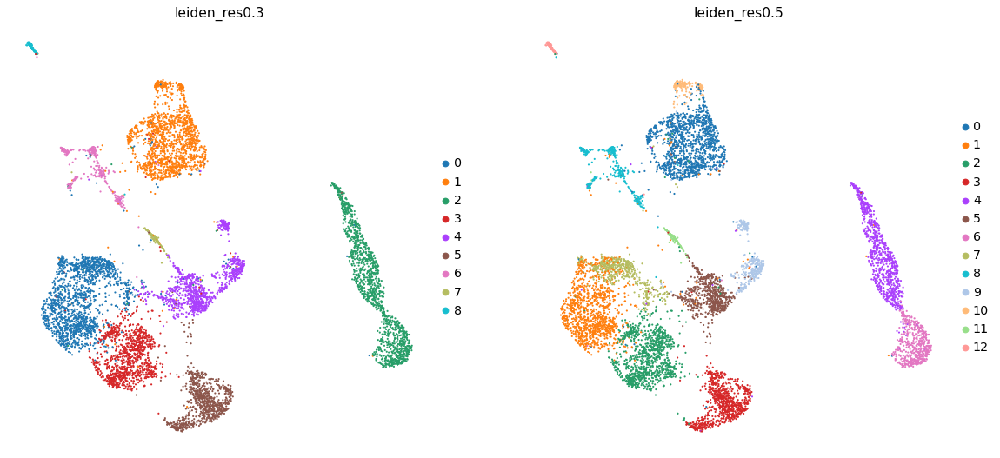

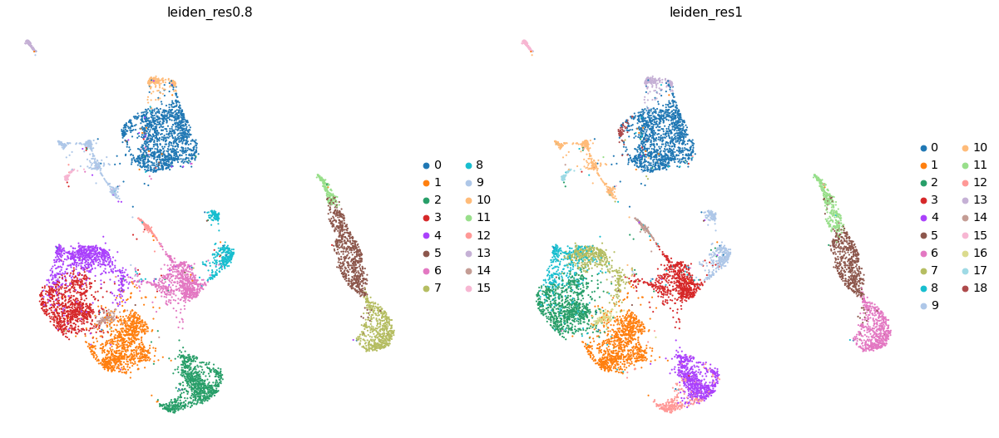

In [12]:
sc.pl.umap(adata_atac, color=['leiden_res0.3', 'leiden_res0.5'])
sc.pl.umap(adata_atac, color=['leiden_res0.8', 'leiden_res1'])

Choose rather coarse resolution that captures the main clusters (here: 0.5)

## QC and marker gene overview

In [13]:
# Select column that should be visualized
leiden_clus_col = 'leiden_res0.5'
# Name for added ranked genes per group
rank_id = 'rank_genes_res0.5'

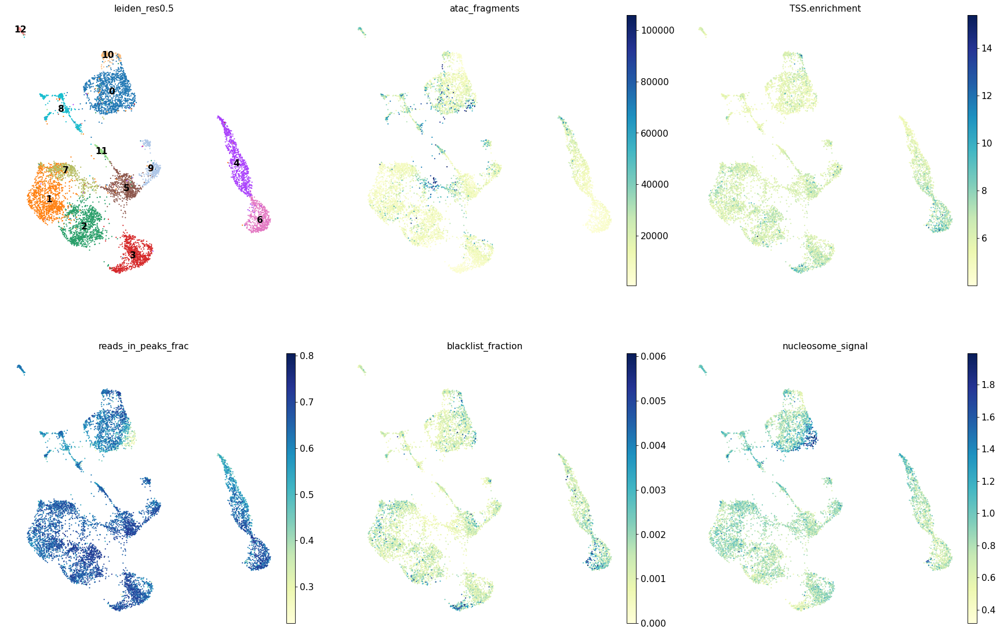

In [14]:
sc.pl.umap(adata_atac, color=[leiden_clus_col, 'atac_fragments', 'TSS.enrichment',
                              'reads_in_peaks_frac','blacklist_fraction','nucleosome_signal'],
          legend_loc = 'on data',
          ncols=3)

In [15]:
sc.tl.rank_genes_groups(adata_atac,
                        groupby= leiden_clus_col,
                        key_added = rank_id)

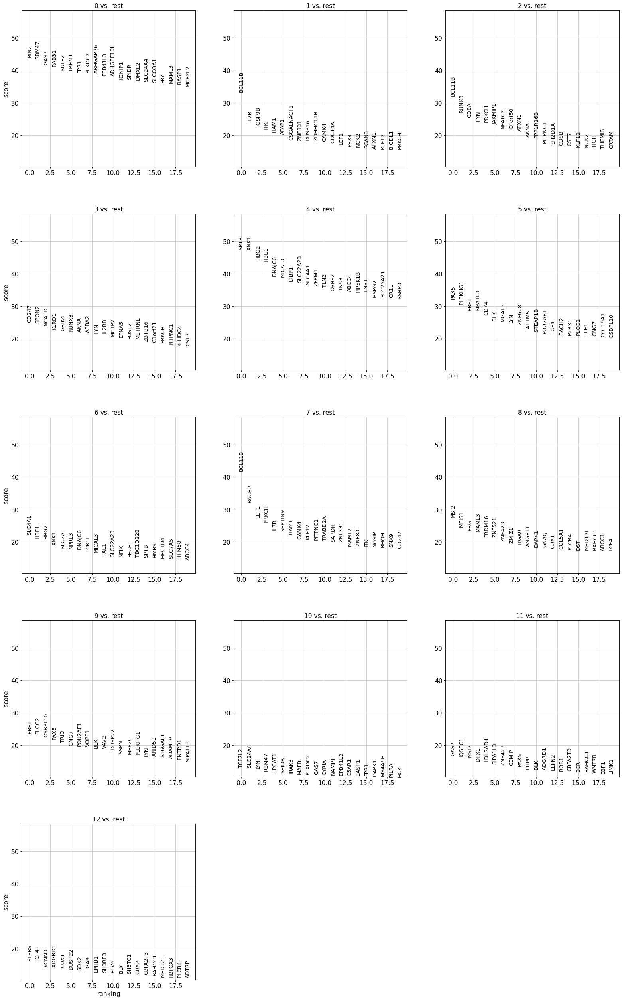

In [16]:
sc.pl.rank_genes_groups(adata_atac, key = rank_id, ncols=3, fontsize=12)

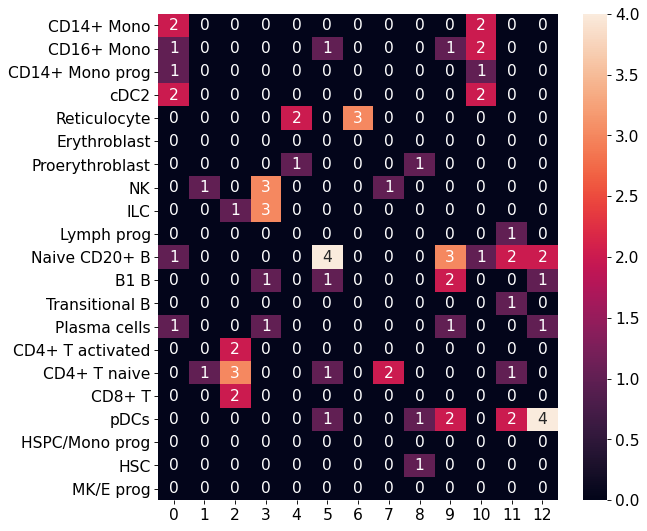

In [17]:
sns.heatmap(sc.tl.marker_gene_overlap(adata_atac,
                                      reference_markers=marker_genes,
                                      key= rank_id), annot=True)

plt.show()

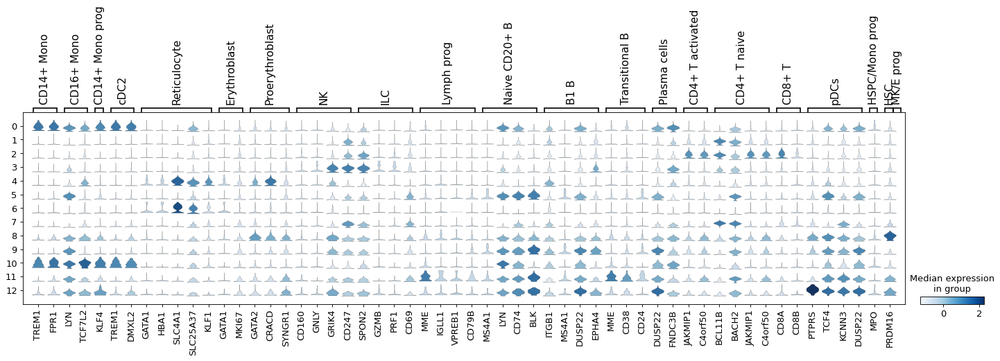

In [18]:
# Reduce to marker genes in gene activity matrix
filt_marker_genes = dict()
for key,val in marker_genes.items():
    filt_vals = [i for i in val if i in adata_atac.var_names]
    filt_marker_genes[key] = filt_vals

# Scale and plot
adata_plot = adata_atac.copy()
sc.pp.scale(adata_plot, max_value=5)
    
sc.pl.stacked_violin(adata_plot, var_names = filt_marker_genes,
                     groupby= leiden_clus_col,
                     use_raw=False)

In [19]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'CD14+ Mono prog', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'pDCs', 'HSPC/Mono prog', 'HSC', 'MK/E prog'])

In [20]:
# Initial clustering:

init_clus_dict = {
    
    '0':['CD 14+ Mono','CD 16+ Mono','cDC2'],
    '1':['CD4+ T'],
    '2':['CD4+ T','CD8+ T'],
    '3':['NK', 'ILC'],
    '4':['Proerythroblast','Reticulocyte'],
    '5':['Naive CD20+ B'],
    '6':['Reticulocyte'],
    '7':['CD4+ T naive'],
    '8':['HSC'],
    '9':['Naive CD20+ B','B1 B'],
    '10':['CD 14+ Mono','CD 16+ Mono','cDC2','CD14+ Mono prog'],
    '11':['Transitional B'],
    '12':['pDCs'],
    
}


### Plot marker genes

Check whether marker gene expression gives hint to subclusters of initial clusters.

Some marker genes are negative: DMXL2 for cDC2; CD69 for ILCs; JAKMIP1 and C4orf50 for naive T cells.

Due to the sparsity of the ATAC data, increased gene activity is not always very obivios. Try to keep keep clear markers for other celltypes in mind.

Cluster: CD14+ Mono


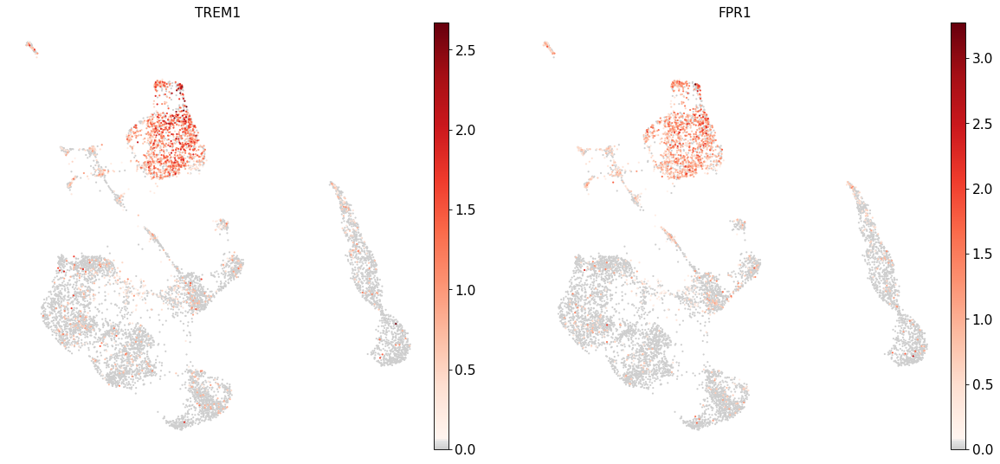

Cluster: CD16+ Mono


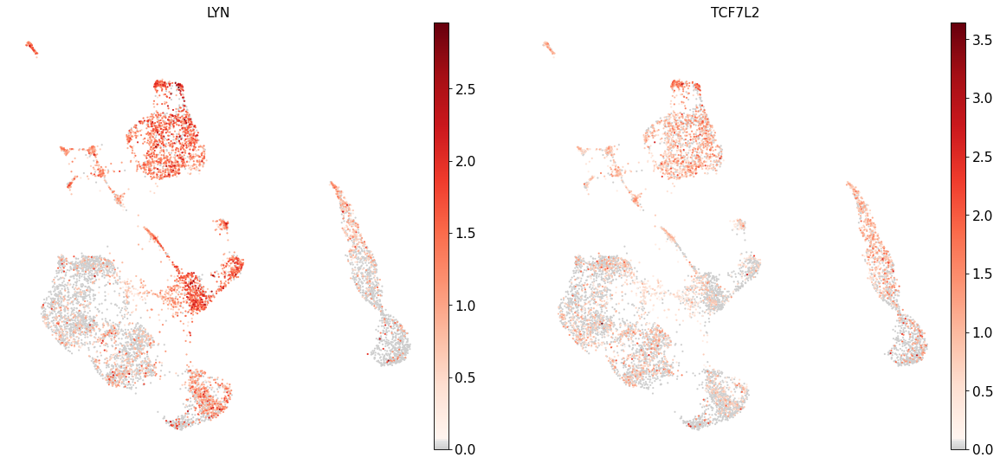

Cluster: CD14+ Mono prog


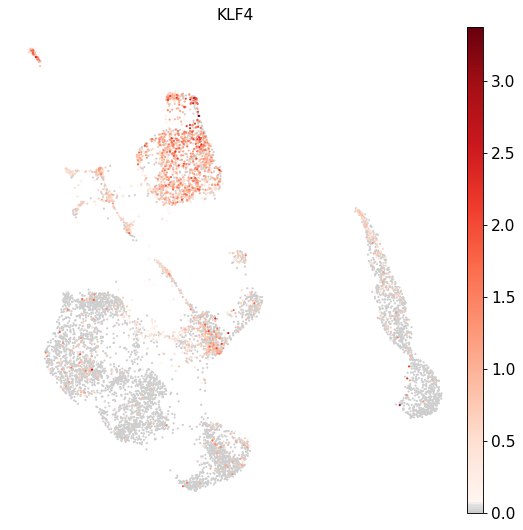

Cluster: cDC2


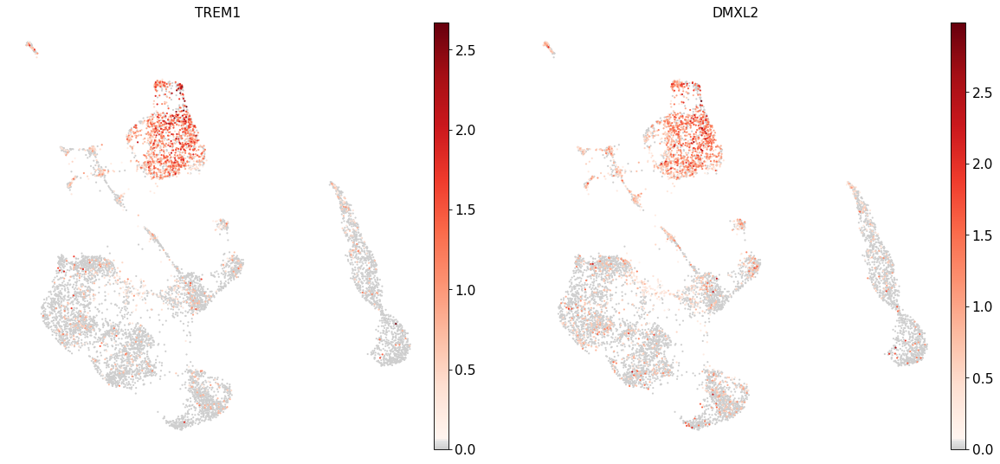

Cluster: Reticulocyte


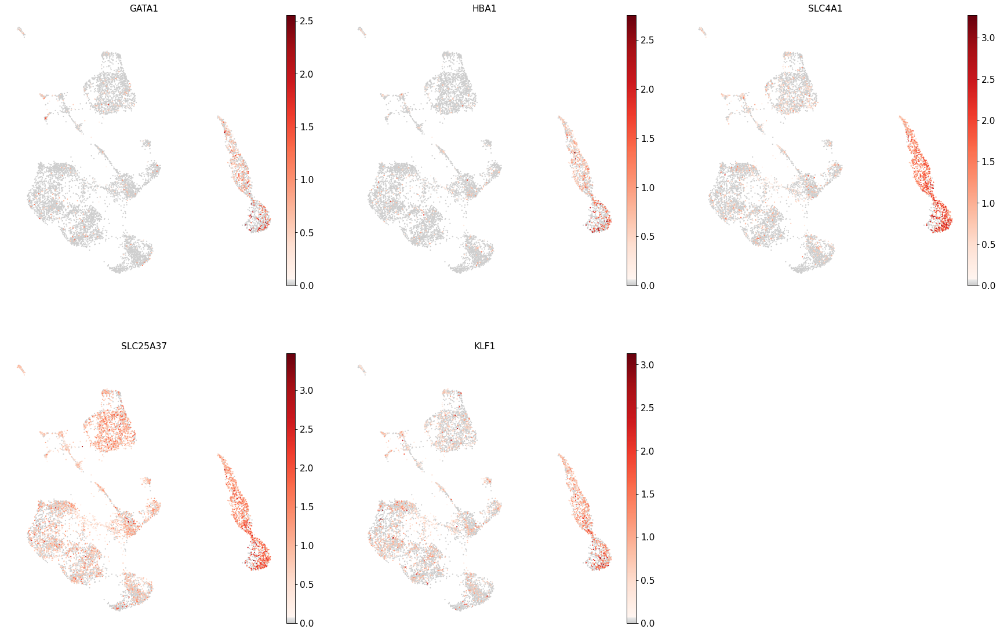

Cluster: Erythroblast


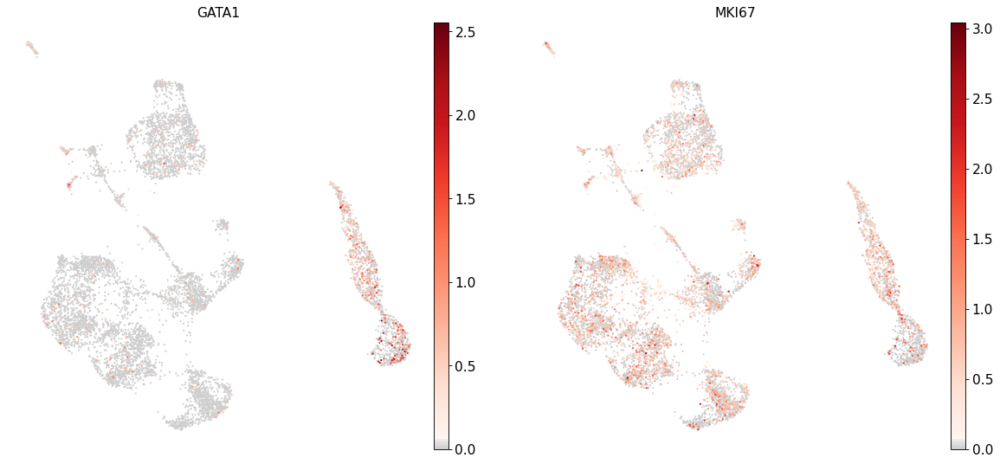

Cluster: Proerythroblast


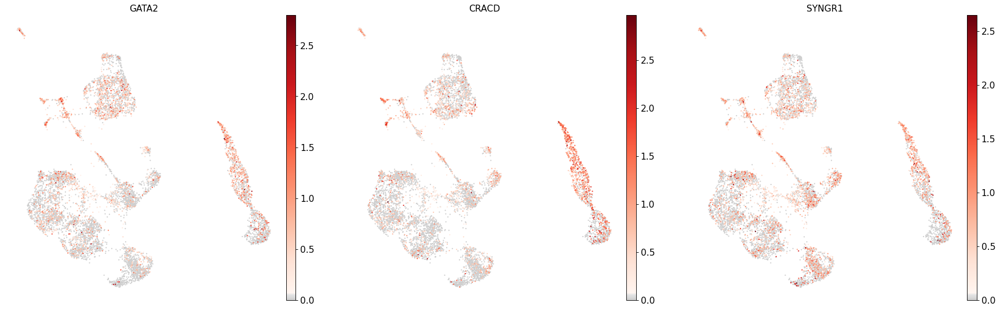

Cluster: NK


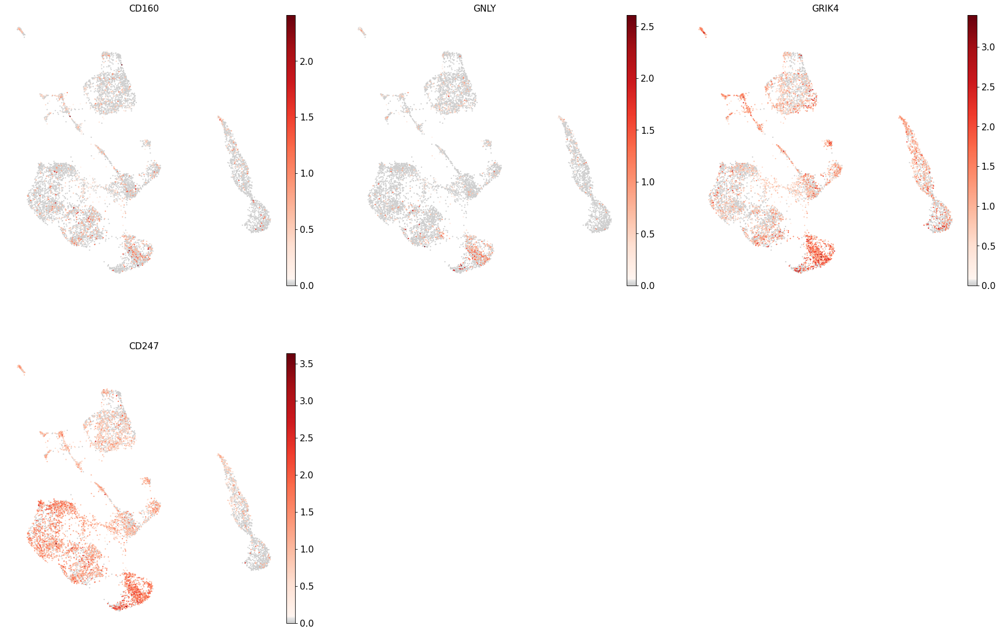

Cluster: ILC


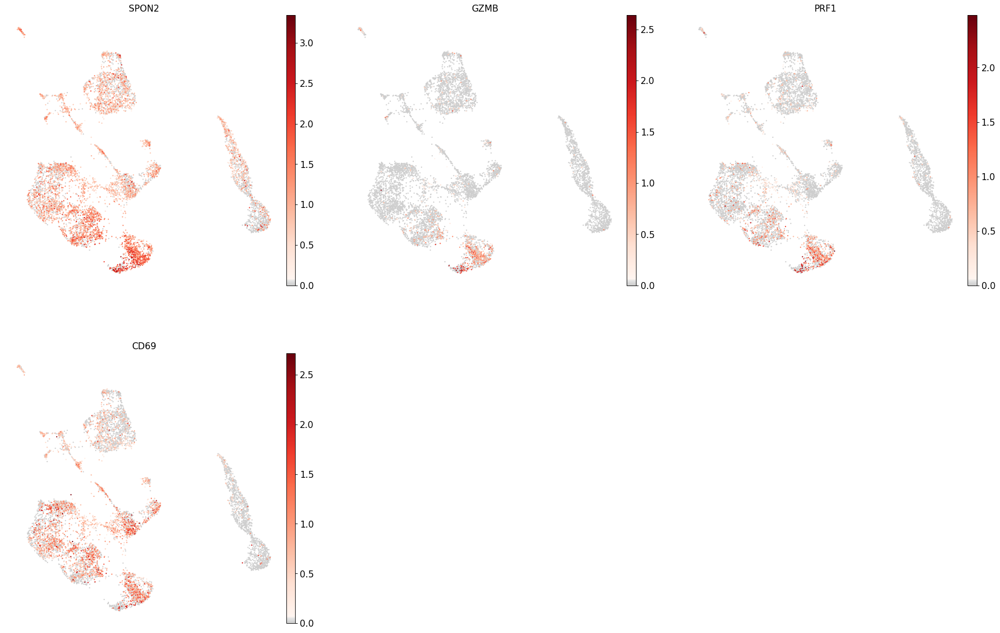

Cluster: Lymph prog


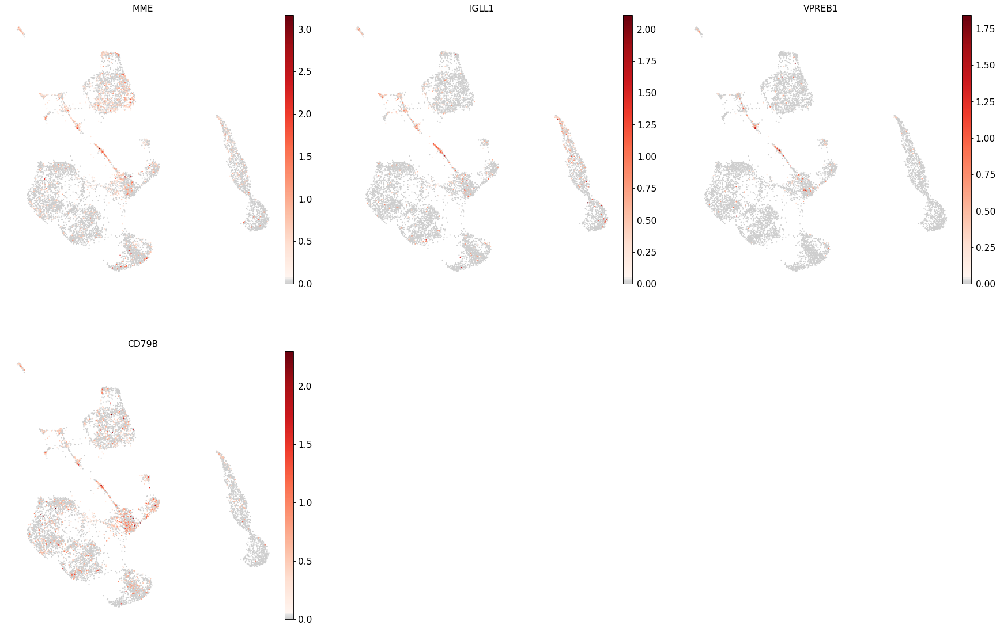

Cluster: Naive CD20+ B


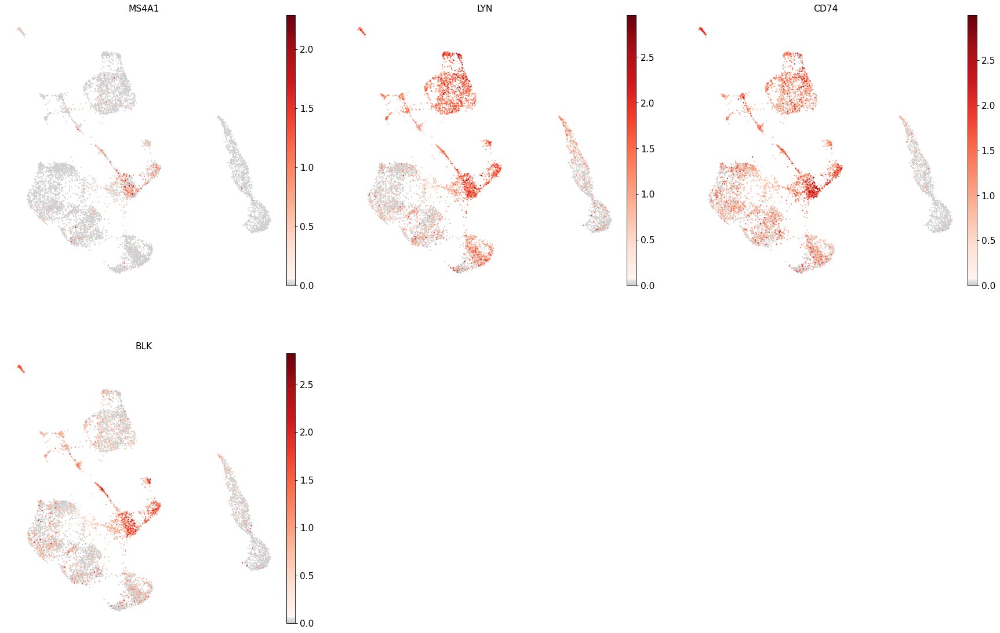

Cluster: B1 B


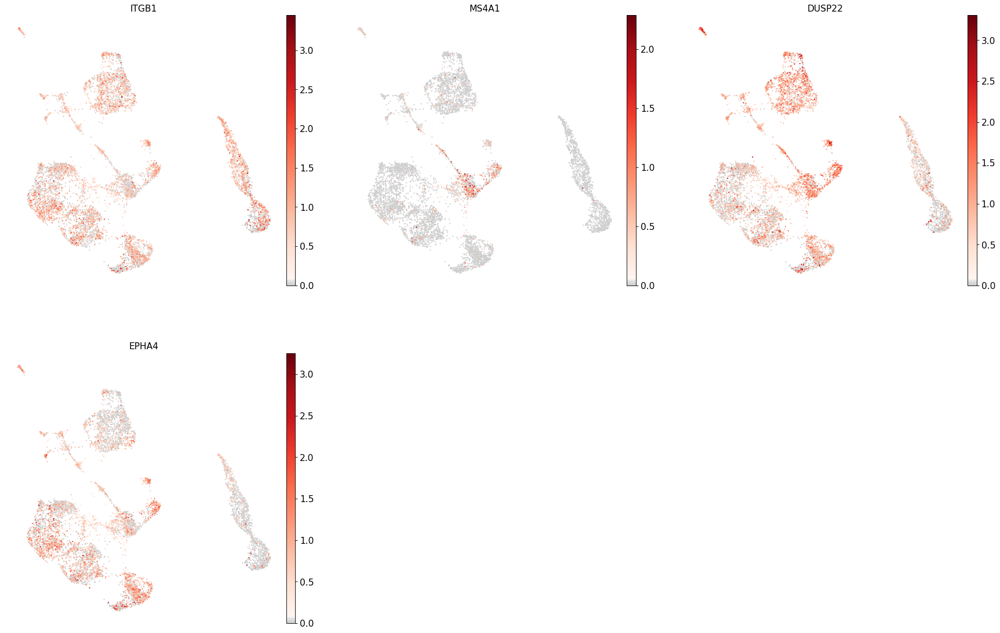

Cluster: Transitional B


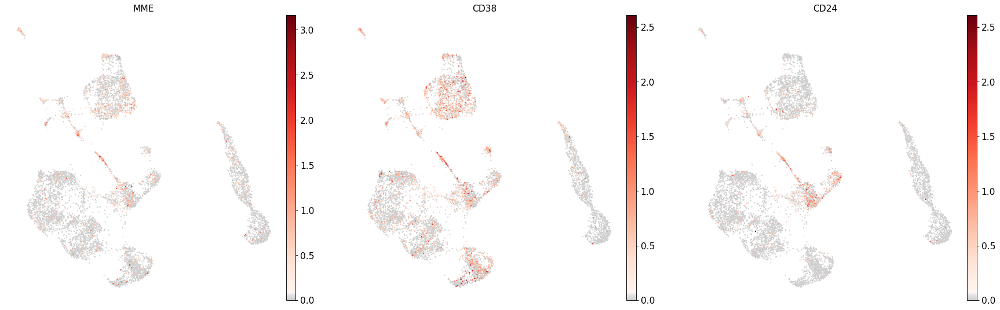

Cluster: Plasma cells


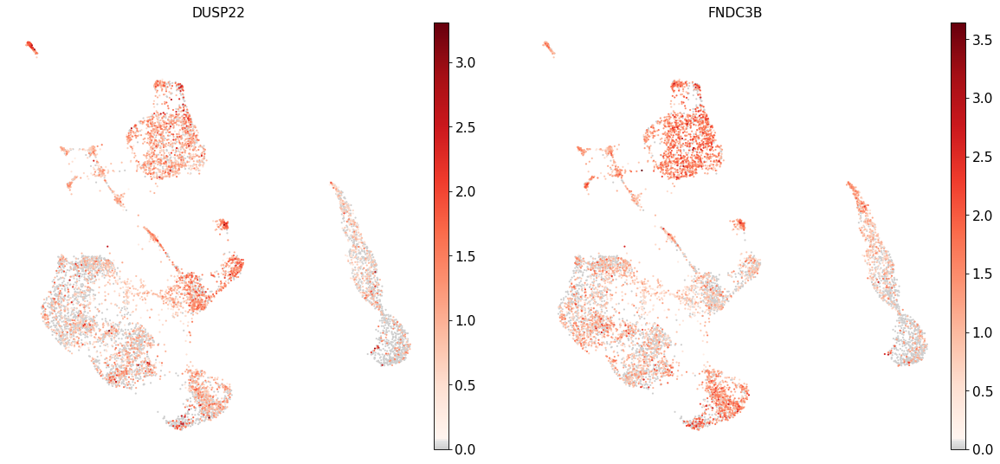

Cluster: CD4+ T activated


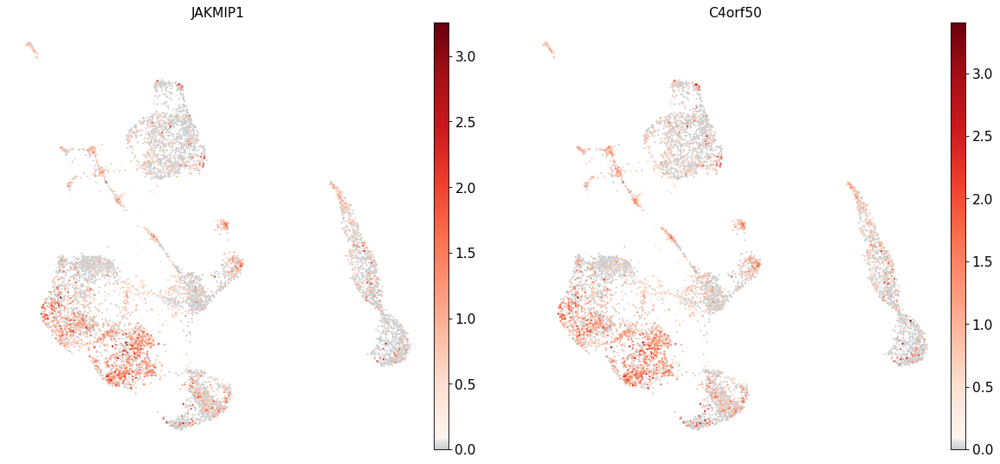

Cluster: CD4+ T naive


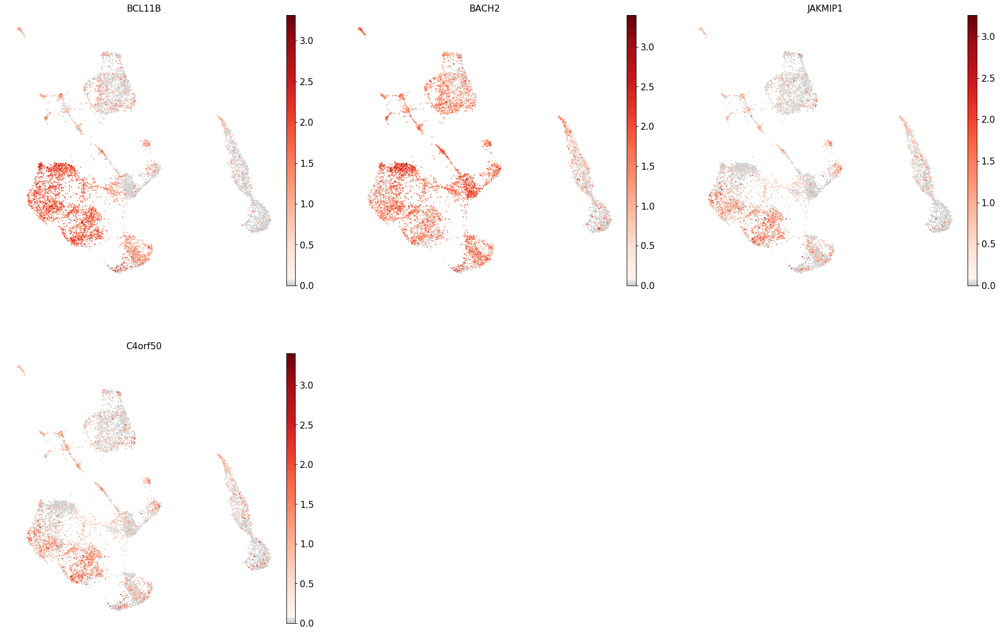

Cluster: CD8+ T


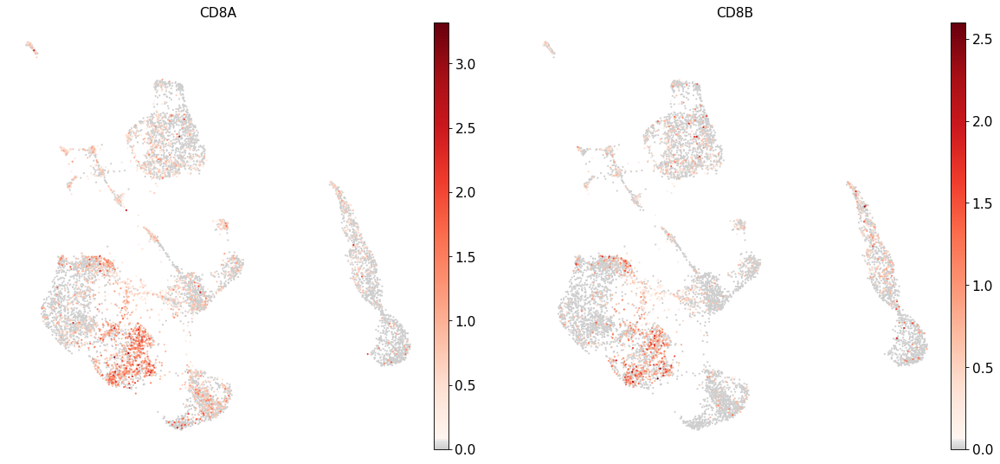

Cluster: pDCs


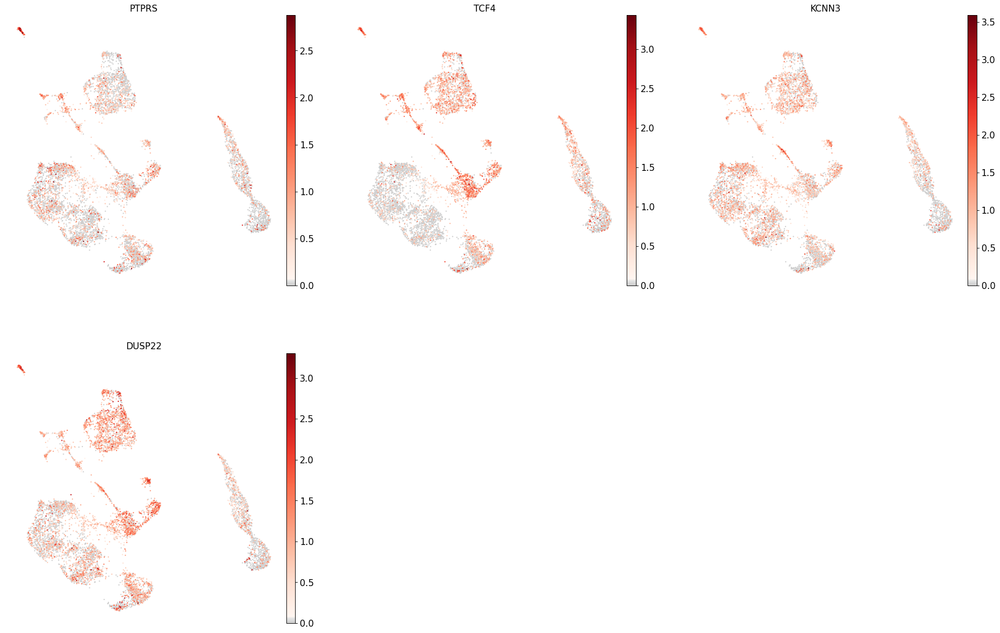

Cluster: HSPC/Mono prog


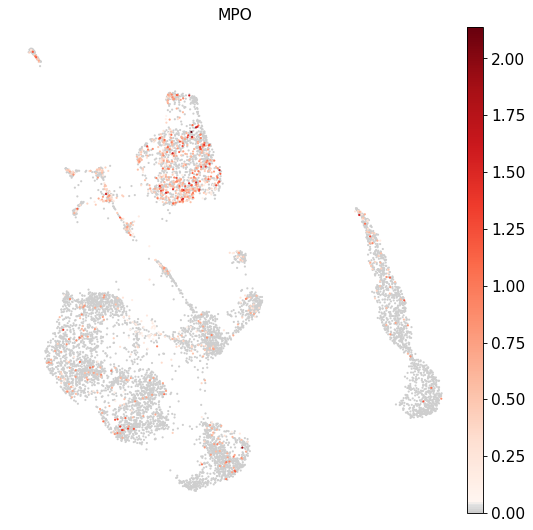

Cluster: HSC


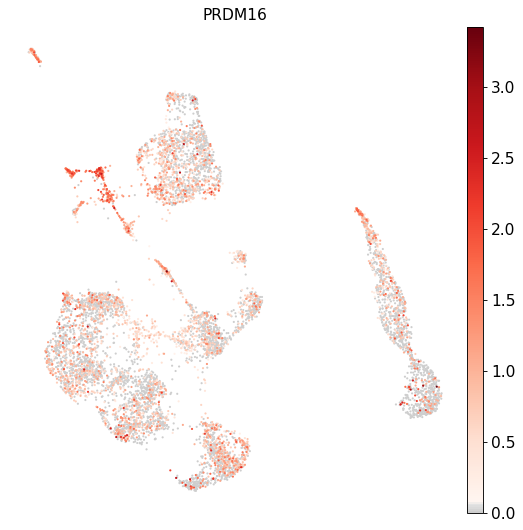

Cluster: MK/E prog


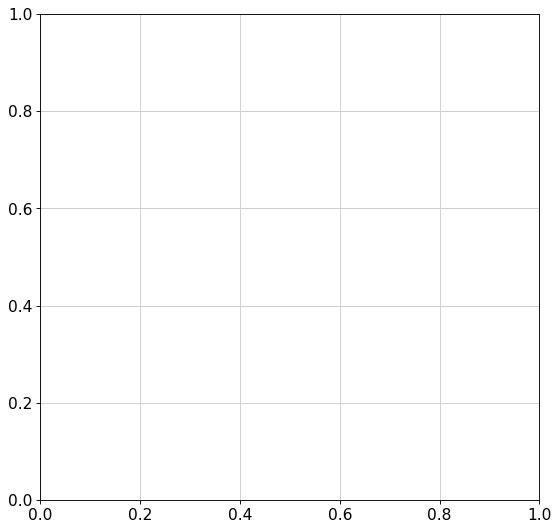

In [21]:
for i in marker_genes.keys():
    print(f'Cluster: {i}')
    genes_to_plot = [i for i in marker_genes[i] if i in adata_atac.var_names]
    sc.pl.umap(adata_atac, color=genes_to_plot, ncols=3, use_raw=False, cmap=mymap)

# Subclustering

Subclustering can be done by considering the marker genes and clustering of clear substructure in the data. Here we go through the clusters based on the major cell types identified above.


## Monocytes and DCs

In [22]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'CD14+ Mono prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'CRACD', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1', 'CD69'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'HSPC/Mono prog': ['MPO'],
 'HSC': ['PRDM16'],
 'MK/E prog': []}

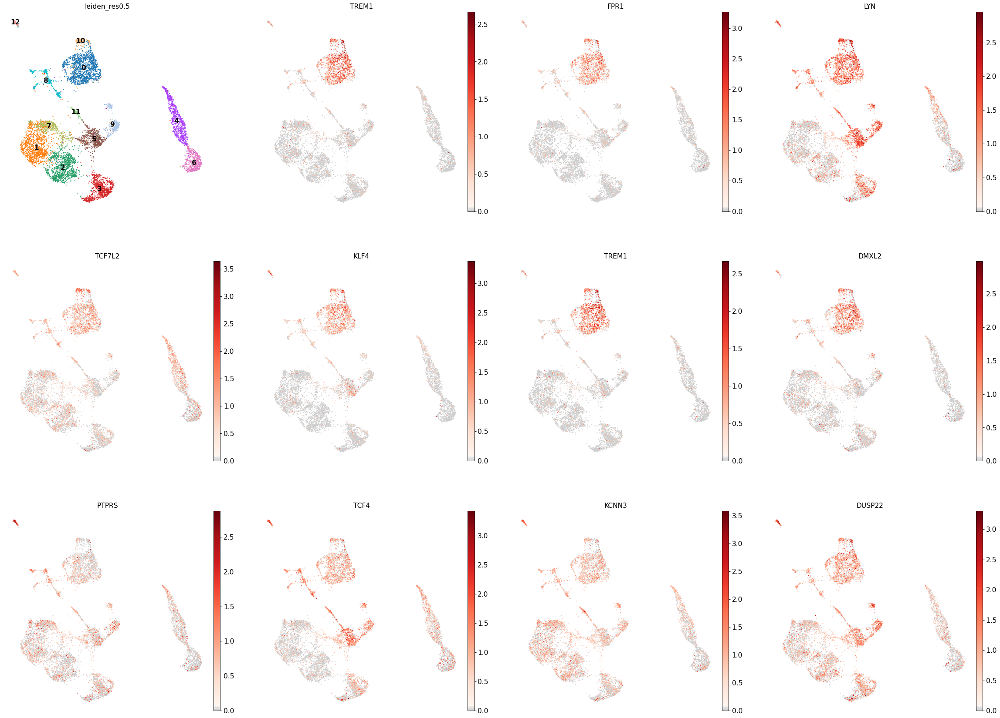

In [23]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = [leiden_clus_col]+
              marker_genes['CD14+ Mono']+
              marker_genes['CD16+ Mono']+
              marker_genes['CD14+ Mono prog']+
              marker_genes['cDC2']+
              marker_genes['pDCs']
          )

### cluster 0

In [24]:
c_id = 0

In [25]:
# Initial assignment
init_clus_dict[str(c_id)]

['CD 14+ Mono', 'CD 16+ Mono', 'cDC2']

#### Split for DMXL negative

For this **first** split, we use the leiden_clus_col as a starting point, for subsequent splits we use the newly generated column to get a final clustering in the end. For testing the correct resolution for each cluster we further work with a temporary cluster column.

In [26]:
# Once the resolution looks good change new_key to leiden final
orig_key = leiden_clus_col
#new_key = 'leiden_temp'
new_key = 'leiden_sub' 
new_rg_key = 'rg_tsub'
sub_key = str(c_id)

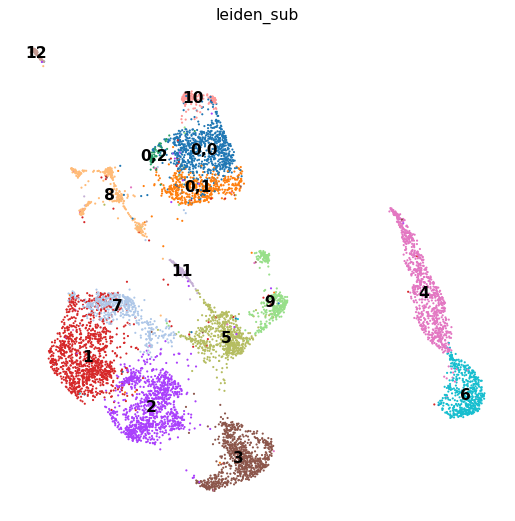

1      1156
2      1069
3       852
4       835
0,0     779
5       659
6       524
7       505
0,1     486
8       355
9       348
10      154
11      116
12      106
0,2      64
Name: leiden_sub, dtype: int64

In [27]:
res=0.2
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()


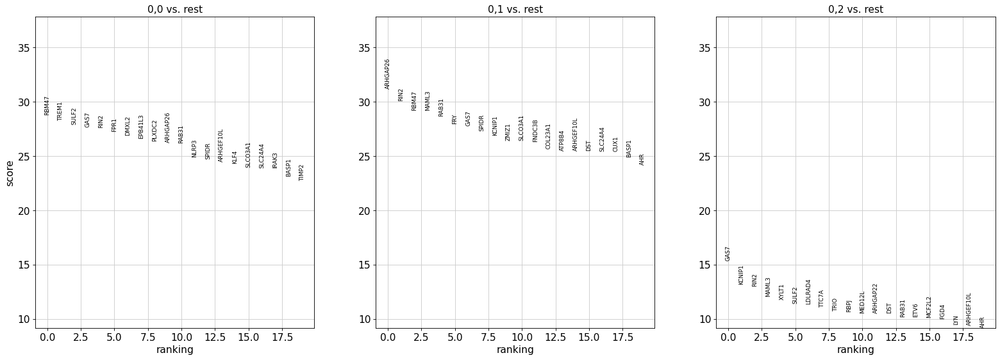

In [28]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 3

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

### cluster 10

In [29]:
c_id = 10

In [30]:
# Initial assignment
init_clus_dict[str(c_id)]

['CD 14+ Mono', 'CD 16+ Mono', 'cDC2', 'CD14+ Mono prog']

#### Split for Mono prog and CD16+

For this **second and subsequent** splits, we use the newly generated column.

In [31]:
# Once the resolution looks good change new_key to leiden_sub
orig_key = 'leiden_sub'
#new_key = 'leiden_temp'
new_key = 'leiden_sub'
new_rg_key = 'rg_tsub'
sub_key = str(c_id)

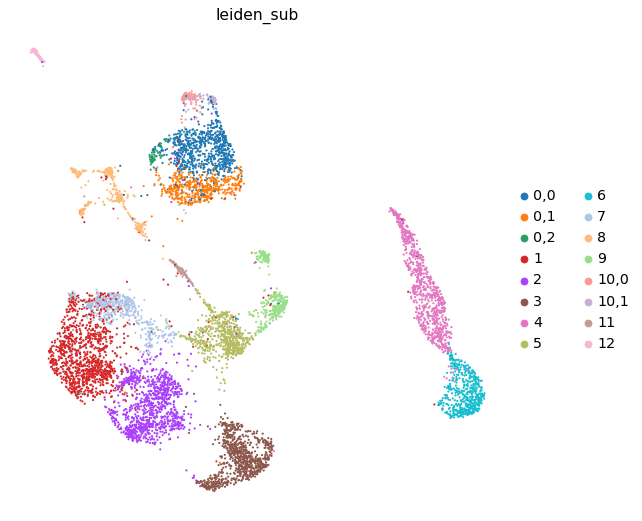

1       1156
2       1069
3        852
4        835
0,0      779
5        659
6        524
7        505
0,1      486
8        355
9        348
11       116
12       106
10,0      81
10,1      73
0,2       64
Name: leiden_sub, dtype: int64

In [32]:
res=0.2
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_atac, color=new_key)#, legend_loc='on data')
adata_atac.obs[new_key].value_counts()


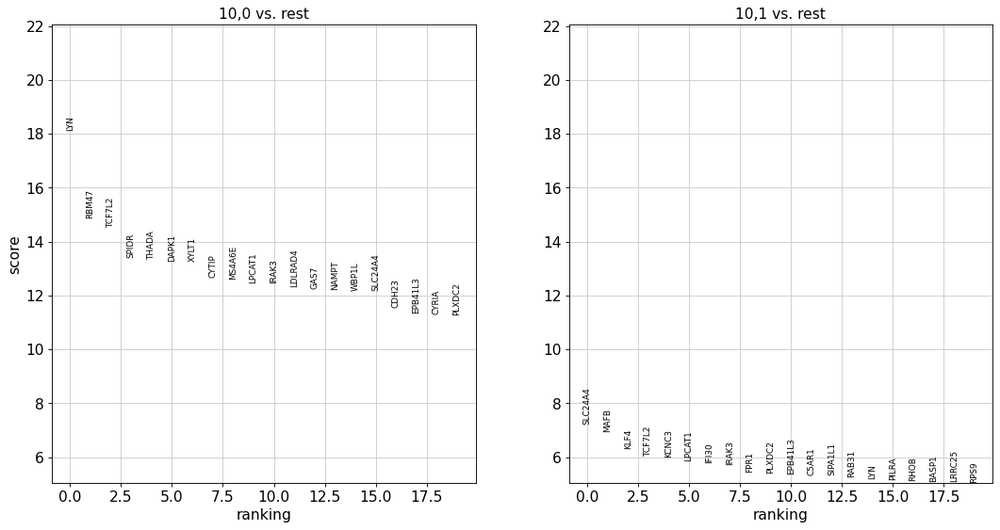

In [33]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

### cluster 12

In [34]:
c_id = 12

In [35]:
# Initial assignment
init_clus_dict[str(c_id)]

['pDCs']

## T cells

In [36]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'CD14+ Mono prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'CRACD', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1', 'CD69'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'HSPC/Mono prog': ['MPO'],
 'HSC': ['PRDM16'],
 'MK/E prog': []}

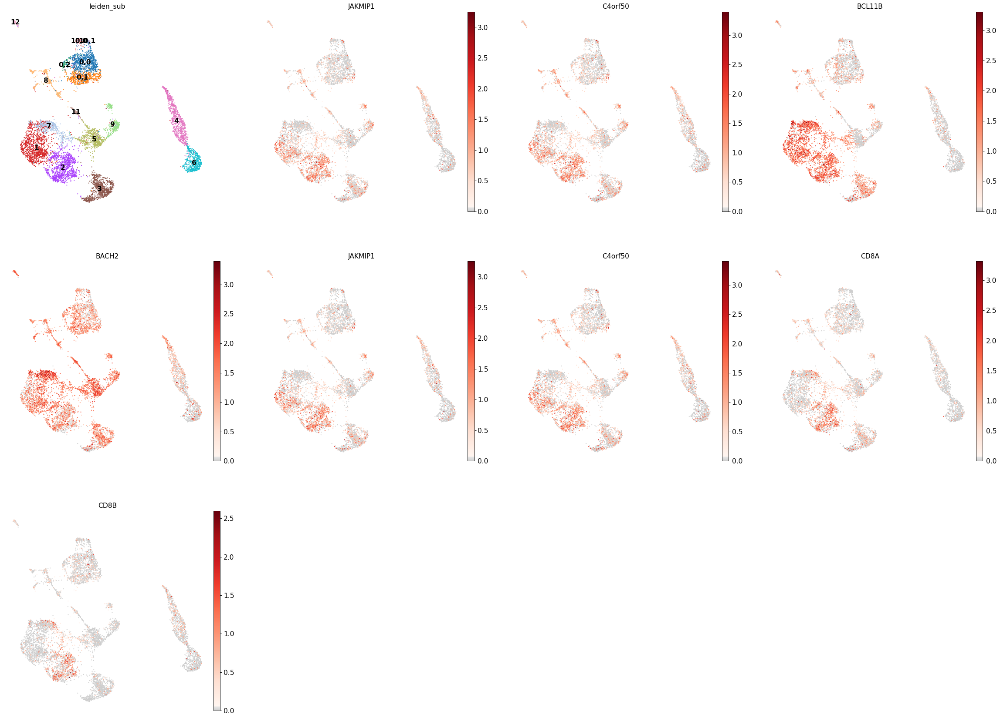

In [37]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = ['leiden_sub']+
              marker_genes['CD4+ T activated']+
              marker_genes['CD4+ T naive']+
              marker_genes['CD8+ T']
          )

### cluster 1

In [38]:
c_id = 1

In [39]:
# Initial assignment
init_clus_dict[str(c_id)]

['CD4+ T']

#### Split for activated vs not activated

In [40]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_sub'
#new_key = 'leiden_temp'
new_key = 'leiden_sub'
new_rg_key = 'rg_tsub'
sub_key = str(c_id)

In [41]:
res=0.4
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

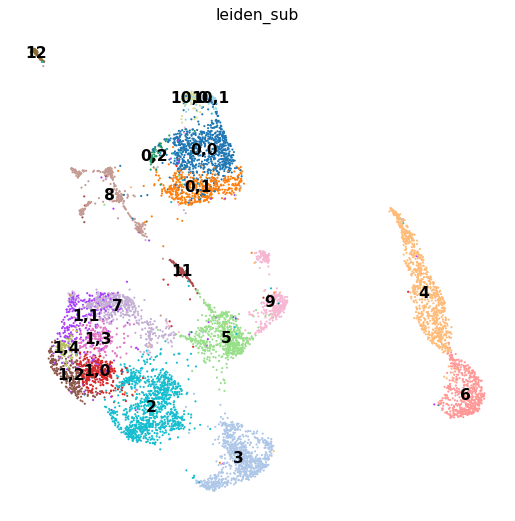

2       1069
3        852
4        835
0,0      779
5        659
6        524
7        505
0,1      486
8        355
9        348
1,0      335
1,1      323
1,2      227
1,3      179
11       116
12       106
1,4       92
10,0      81
10,1      73
0,2       64
Name: leiden_sub, dtype: int64

In [42]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

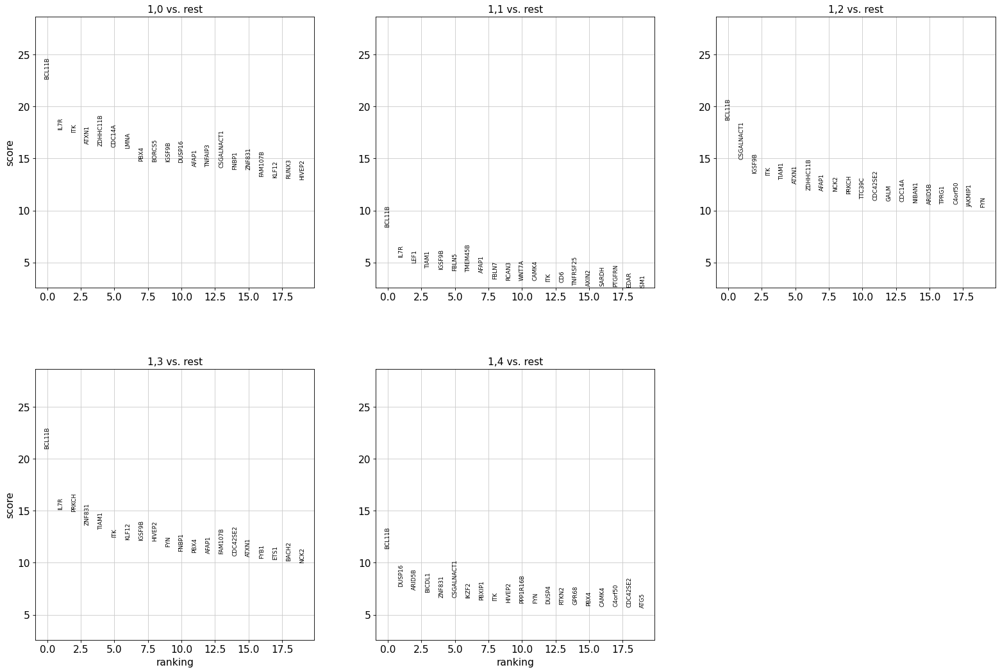

In [43]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 5

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

### cluster 2

In [44]:
c_id = 2

In [45]:
# Initial assignment
init_clus_dict[str(c_id)]

['CD4+ T', 'CD8+ T']

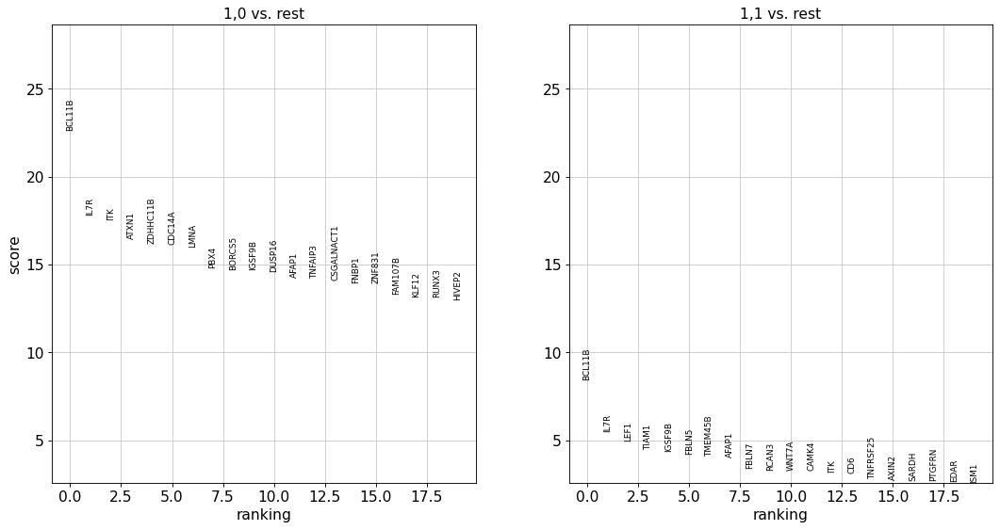

In [46]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

### cluster 7

In [47]:
c_id = 7

In [48]:
# Initial assignment
init_clus_dict[str(c_id)]

['CD4+ T naive']

#### Split substructure

In [49]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_sub'
#new_key = 'leiden_temp'
new_key = 'leiden_sub'
new_rg_key = 'rg_tsub'
sub_key = str(c_id)

In [50]:
res=0.2
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

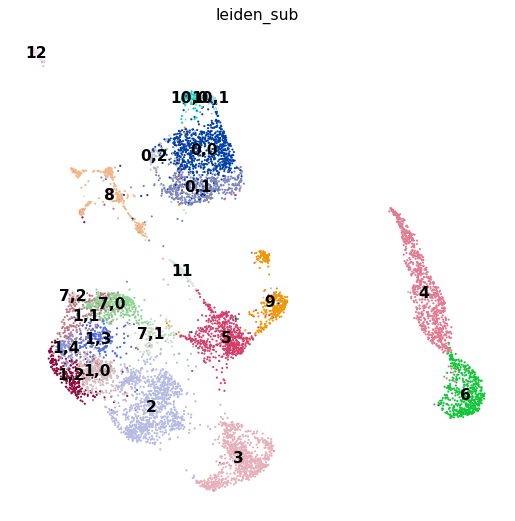

2       1069
3        852
4        835
0,0      779
5        659
6        524
0,1      486
7,0      372
8        355
9        348
1,0      335
1,1      323
1,2      227
1,3      179
11       116
12       106
7,1      105
1,4       92
10,0      81
10,1      73
0,2       64
7,2       28
Name: leiden_sub, dtype: int64

In [51]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

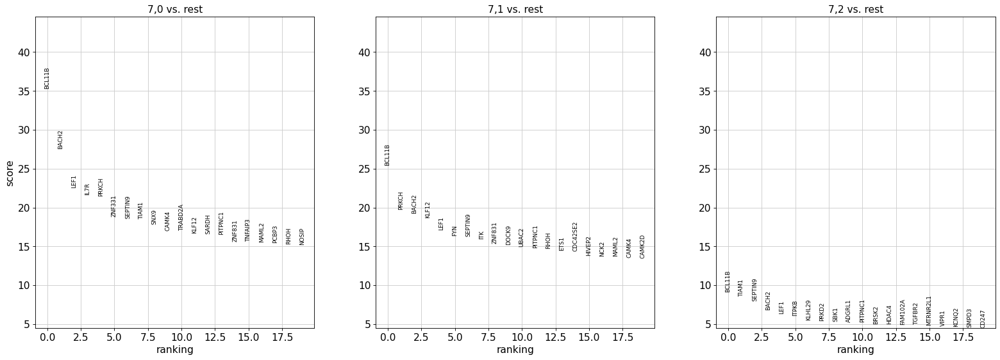

In [52]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 3

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

## NK - ILC

In [53]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'CD14+ Mono prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'CRACD', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1', 'CD69'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'HSPC/Mono prog': ['MPO'],
 'HSC': ['PRDM16'],
 'MK/E prog': []}

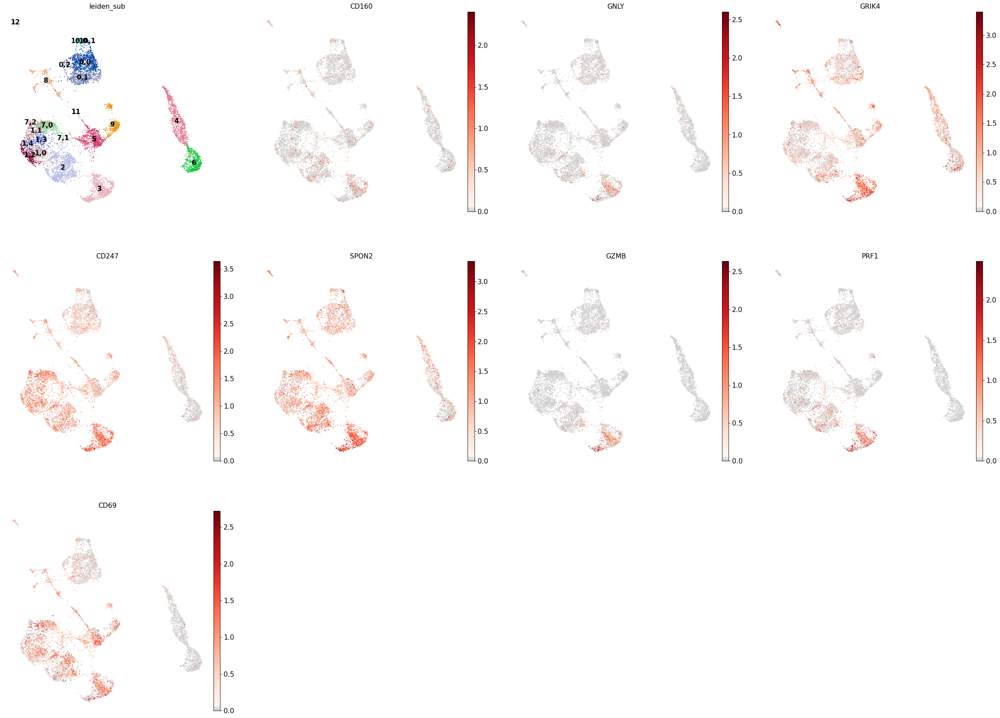

In [54]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = ['leiden_sub']+
              marker_genes['NK']+
              marker_genes['ILC']
          )

### cluster 3

In [55]:
c_id = 3

In [56]:
# Initial assignment
init_clus_dict[str(c_id)]

['NK', 'ILC']

#### Split for activated vs not activated

In [57]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_sub'
#new_key = 'leiden_temp'
new_key = 'leiden_sub'
new_rg_key = 'rg_tsub'
sub_key = str(c_id)

In [58]:
res=0.2
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

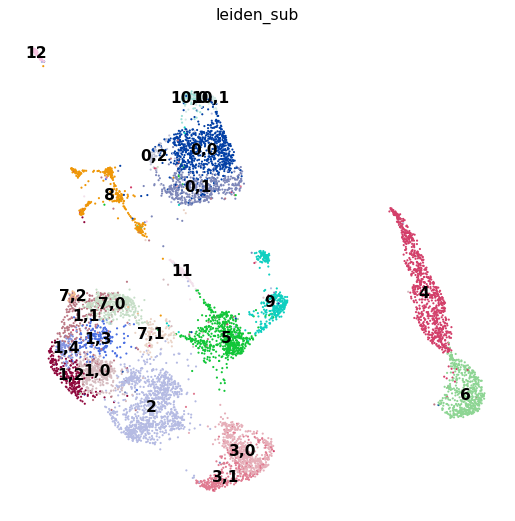

2       1069
4        835
0,0      779
5        659
3,0      533
6        524
0,1      486
7,0      372
8        355
9        348
1,0      335
1,1      323
3,1      319
1,2      227
1,3      179
11       116
12       106
7,1      105
1,4       92
10,0      81
10,1      73
0,2       64
7,2       28
Name: leiden_sub, dtype: int64

In [59]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

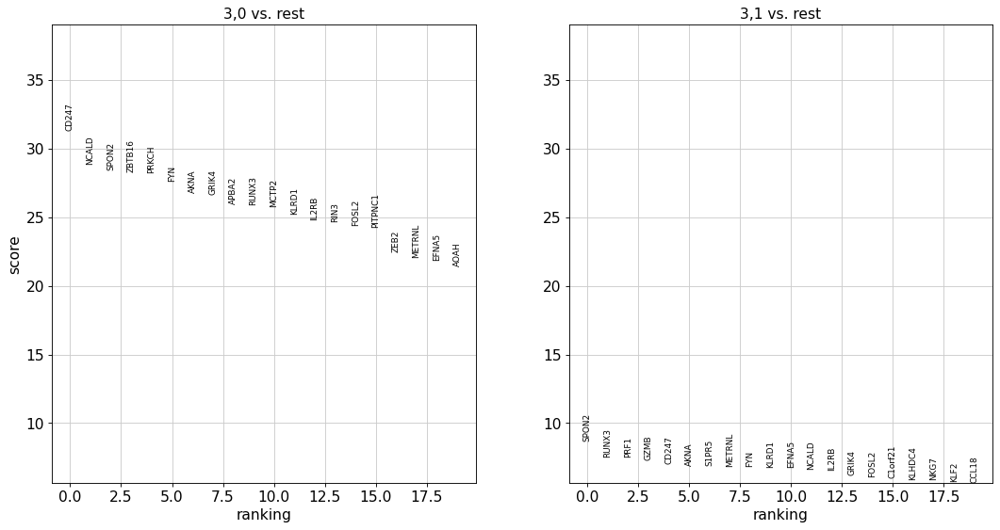

In [60]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

## Proerythroblast - Erythroblast - Reticulocyte

In [61]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'CD14+ Mono prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'CRACD', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1', 'CD69'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'HSPC/Mono prog': ['MPO'],
 'HSC': ['PRDM16'],
 'MK/E prog': []}

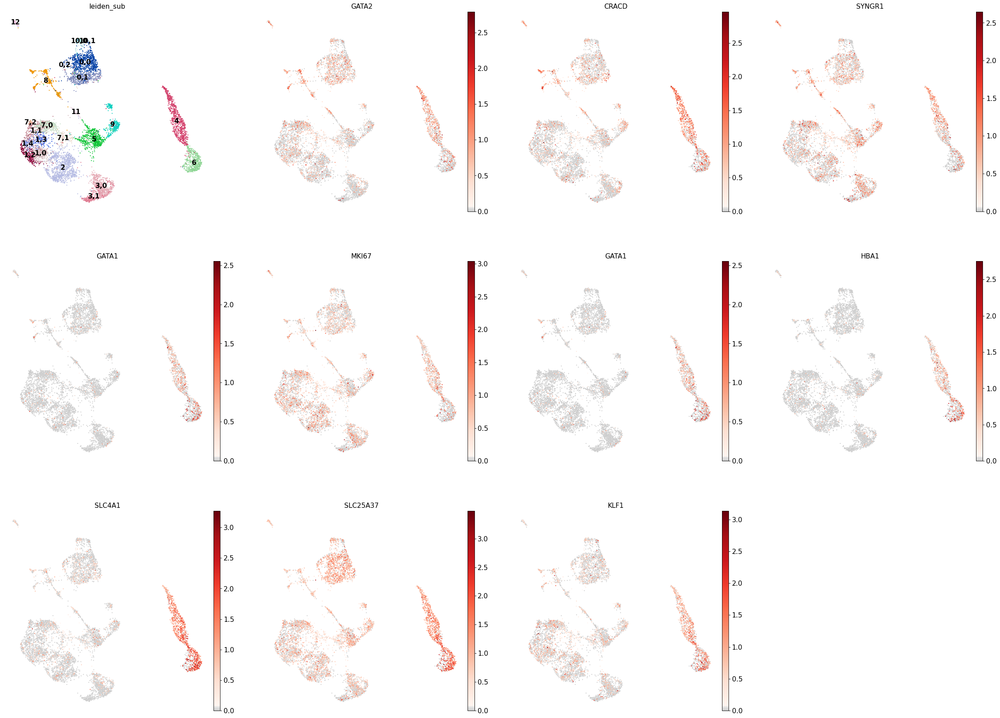

In [62]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = ['leiden_sub']+
           marker_genes['Proerythroblast']+
           marker_genes['Erythroblast']+
           marker_genes['Reticulocyte']
          )

### cluster 4

In [63]:
c_id = 4

In [64]:
# Initial assignment
init_clus_dict[str(c_id)]

['Proerythroblast', 'Reticulocyte']

#### Split for activated vs not activated

In [65]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_sub'
#new_key = 'leiden_temp'
new_key = 'leiden_sub'
new_rg_key = 'rg_tsub'
sub_key = str(c_id)

In [66]:
res=0.1
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

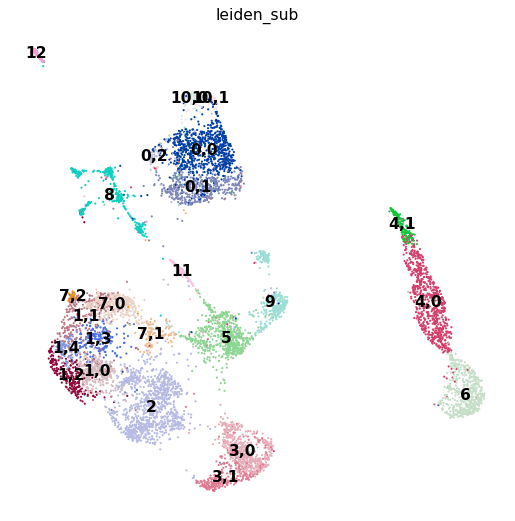

2       1069
0,0      779
4,0      687
5        659
3,0      533
6        524
0,1      486
7,0      372
8        355
9        348
1,0      335
1,1      323
3,1      319
1,2      227
1,3      179
4,1      148
11       116
12       106
7,1      105
1,4       92
10,0      81
10,1      73
0,2       64
7,2       28
Name: leiden_sub, dtype: int64

In [67]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

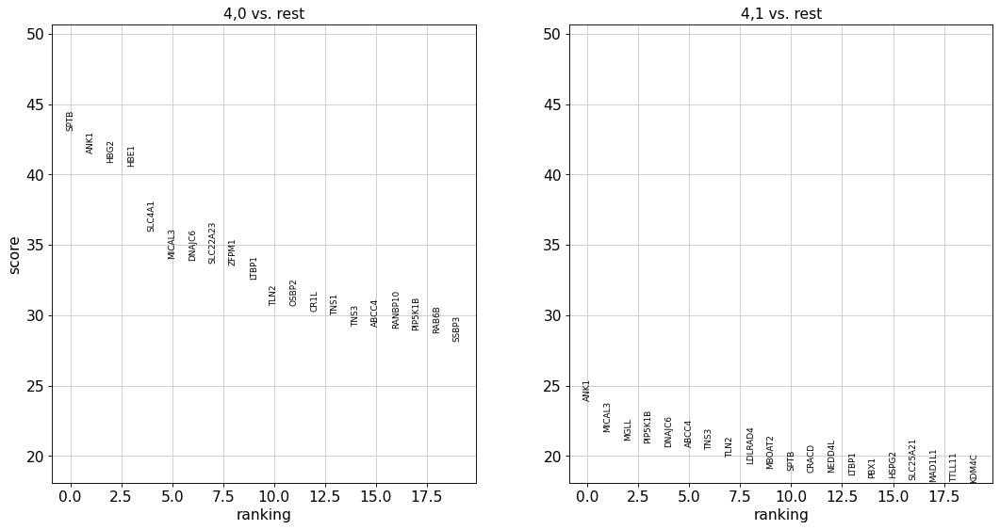

In [68]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

### cluster 6

In [69]:
c_id = 6

In [70]:
# Initial assignment
init_clus_dict[str(c_id)]

['Reticulocyte']

## B cells - Plasma

In [71]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'CD14+ Mono prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'CRACD', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1', 'CD69'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'HSPC/Mono prog': ['MPO'],
 'HSC': ['PRDM16'],
 'MK/E prog': []}

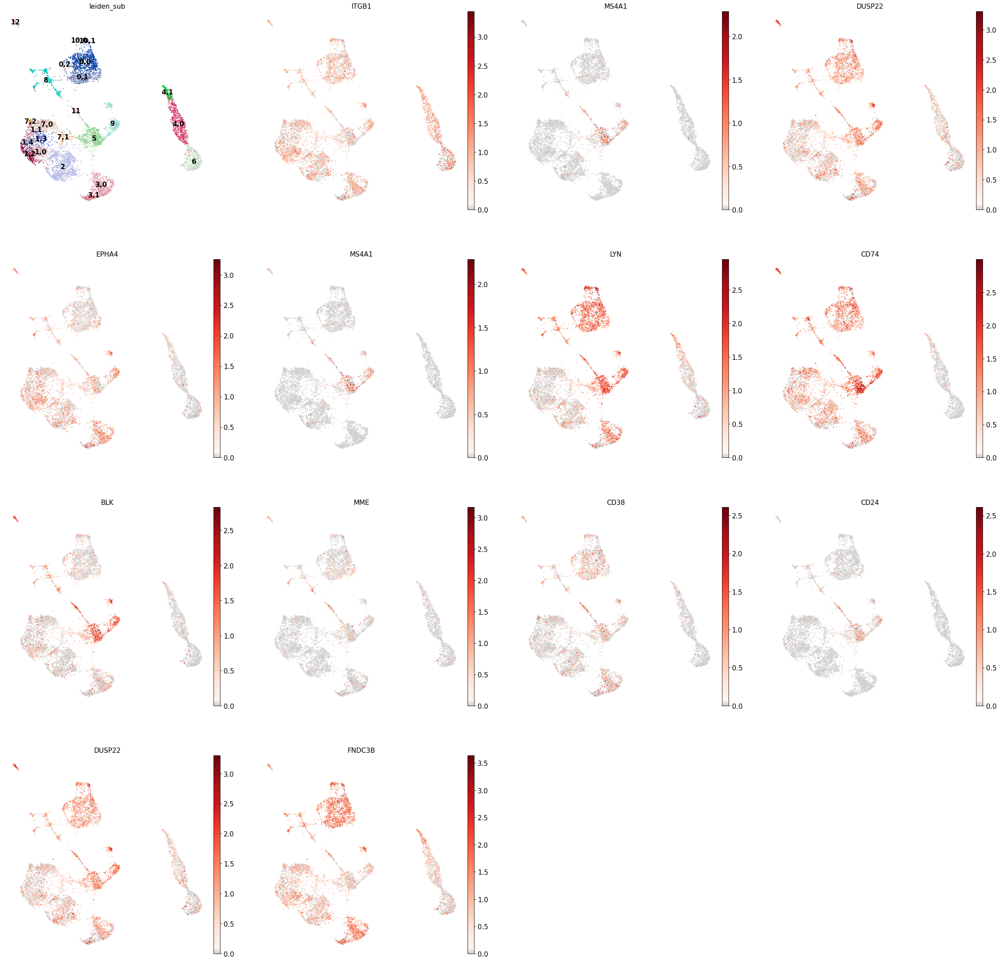

In [72]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = ['leiden_sub']+
           marker_genes['B1 B']+
           marker_genes['Naive CD20+ B']+
           marker_genes['Transitional B']+
           marker_genes['Plasma cells']
          )

### cluster 5

In [73]:
c_id = 5

In [74]:
# Initial assignment
init_clus_dict[str(c_id)]

['Naive CD20+ B']

### cluster 9

In [75]:
c_id = 9

In [76]:
# Initial assignment
init_clus_dict[str(c_id)]

['Naive CD20+ B', 'B1 B']

#### Split substructure

In [77]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_sub'
#new_key = 'leiden_temp'
new_key = 'leiden_sub'
new_rg_key = 'rg_tsub'
sub_key = str(c_id)

In [78]:
res=0.1
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

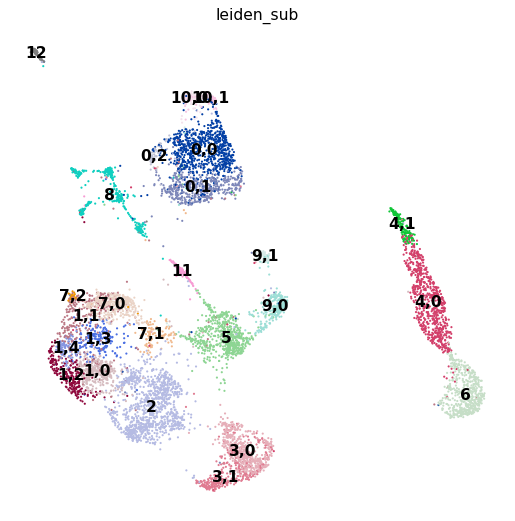

2       1069
0,0      779
4,0      687
5        659
3,0      533
6        524
0,1      486
7,0      372
8        355
1,0      335
1,1      323
3,1      319
9,0      255
1,2      227
1,3      179
4,1      148
11       116
12       106
7,1      105
9,1       93
1,4       92
10,0      81
10,1      73
0,2       64
7,2       28
Name: leiden_sub, dtype: int64

In [79]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

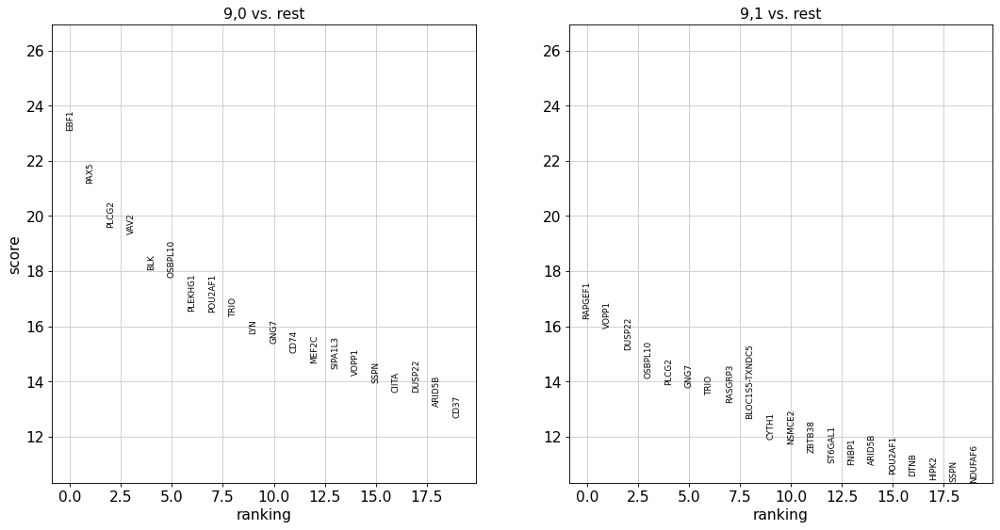

In [80]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

### cluster 11

In [81]:
c_id = 11

In [82]:
# Initial assignment
init_clus_dict[str(c_id)]

['Transitional B']

## Stem/Progenitors

Not all of the 5 clusters of progenitor cell show distinct marker genes, but there's a clear stubstructure. Therefore, we split the clusters and look for marker genes. If the default t-test doesn't return good markers, one can try to set the method to logistic regression ('logreg').
We then later compare the clusters to the clusters obtained from RNA expression and hopefully will be able to define the progenitor subtype.

In [83]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'CD14+ Mono prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'CRACD', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1', 'CD69'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'HSPC/Mono prog': ['MPO'],
 'HSC': ['PRDM16'],
 'MK/E prog': []}

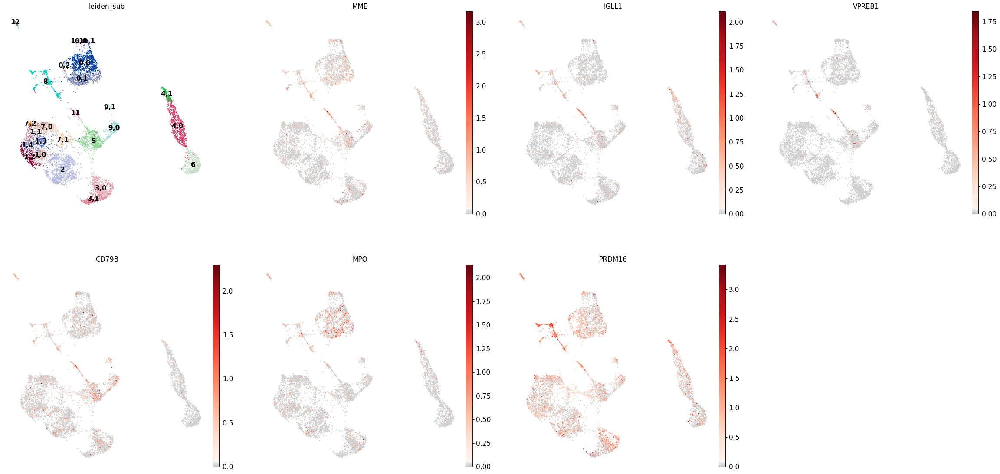

In [84]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = ['leiden_sub']+
              marker_genes['Lymph prog']+
              marker_genes['HSPC/Mono prog']+
              marker_genes['HSC']
          ) 

### cluster 8

In [85]:
c_id = 8

In [86]:
# Initial assignment
init_clus_dict[str(c_id)]

['HSC']

#### Split substructure

In [87]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_sub'
#new_key = 'leiden_temp'
new_key = 'leiden_sub'
new_rg_key = 'rg_tsub'
sub_key = str(c_id)

In [88]:
res=0.3
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

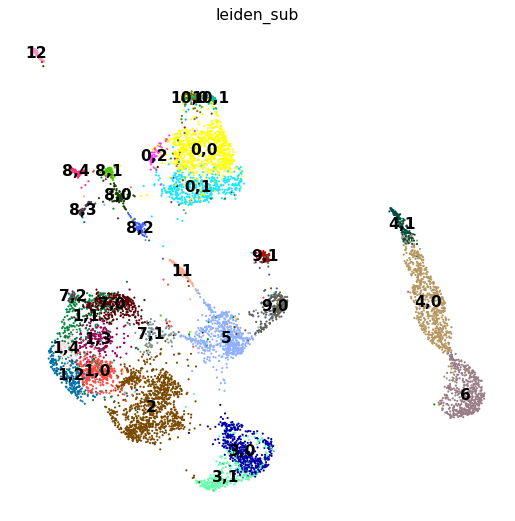

2       1069
0,0      779
4,0      687
5        659
3,0      533
6        524
0,1      486
7,0      372
1,0      335
1,1      323
3,1      319
9,0      255
1,2      227
1,3      179
4,1      148
11       116
12       106
7,1      105
9,1       93
1,4       92
8,0       90
10,0      81
10,1      73
8,1       72
8,2       66
8,3       64
0,2       64
8,4       63
7,2       28
Name: leiden_sub, dtype: int64

In [89]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

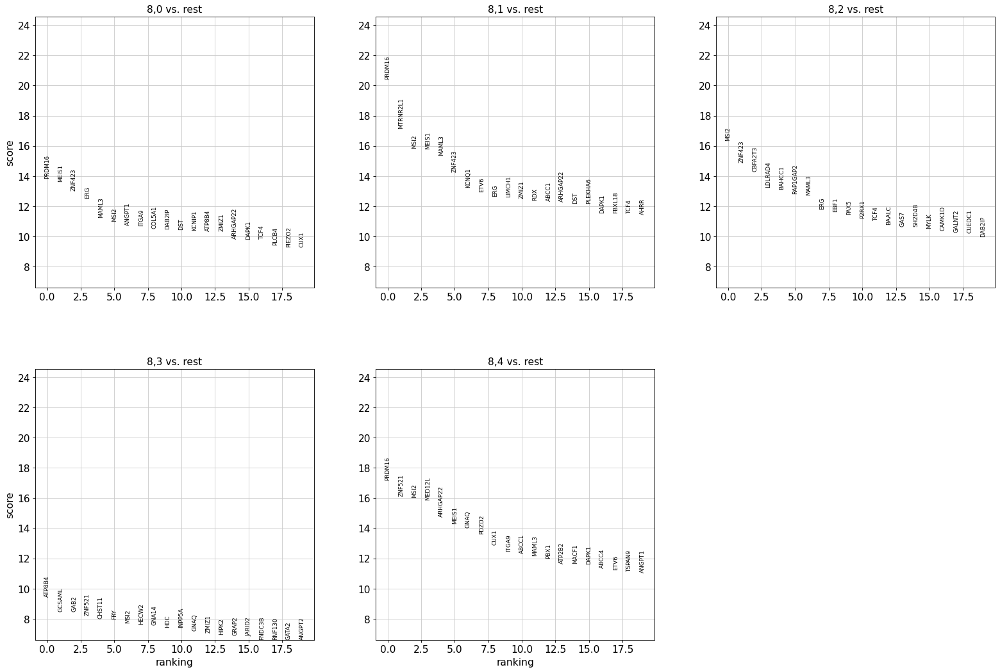

In [90]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 5

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

In [91]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
top_2_genes

['PRDM16',
 'PRDM16',
 'MSI2',
 'ATP8B4',
 'PRDM16',
 'MEIS1',
 'MTRNR2L1',
 'ZNF423',
 'GCSAML',
 'ZNF521']

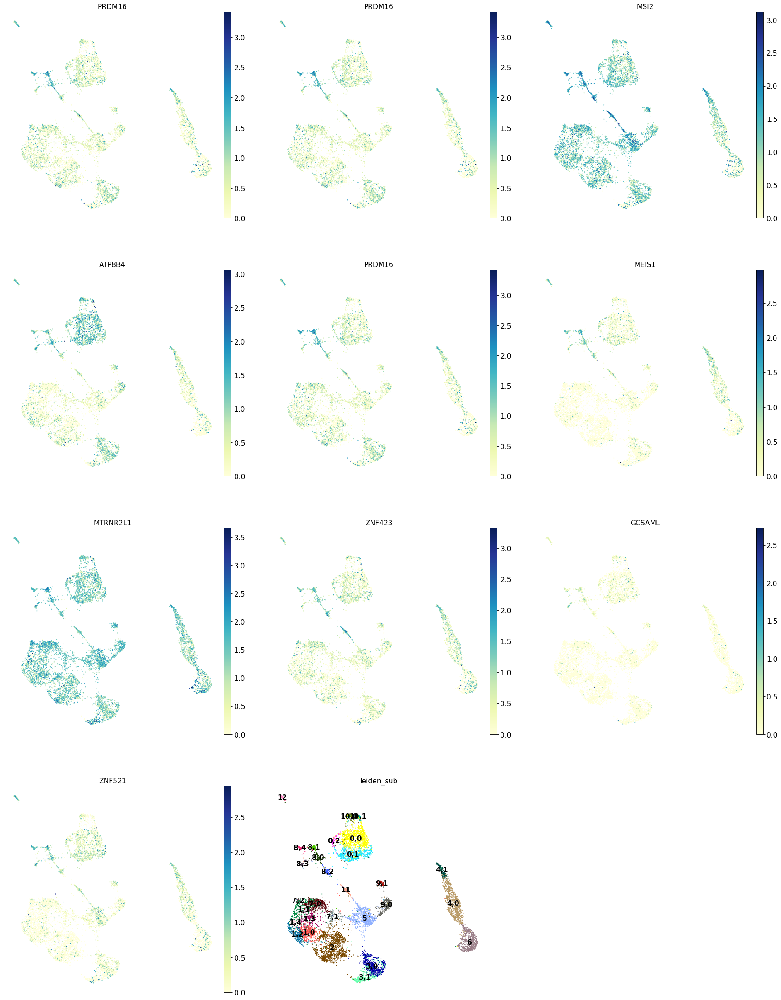

In [92]:
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3, legend_loc = 'on data')

/home/icb/christopher.lance/miniconda3/envs/neur_data_ann/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


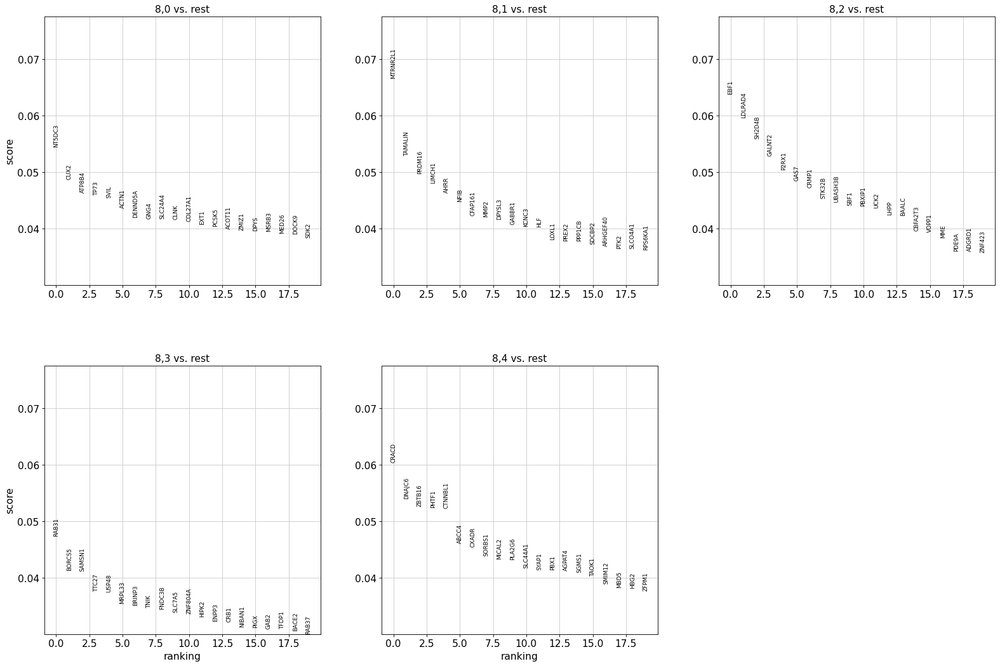

In [93]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 5

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key,
                        groups=new_groups, method='logreg')
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

In [94]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
top_2_genes


['NT5DC3',
 'MTRNR2L1',
 'EBF1',
 'RAB31',
 'CRACD',
 'CUX2',
 'TAMALIN',
 'LDLRAD4',
 'BORCS5',
 'DNAJC6']

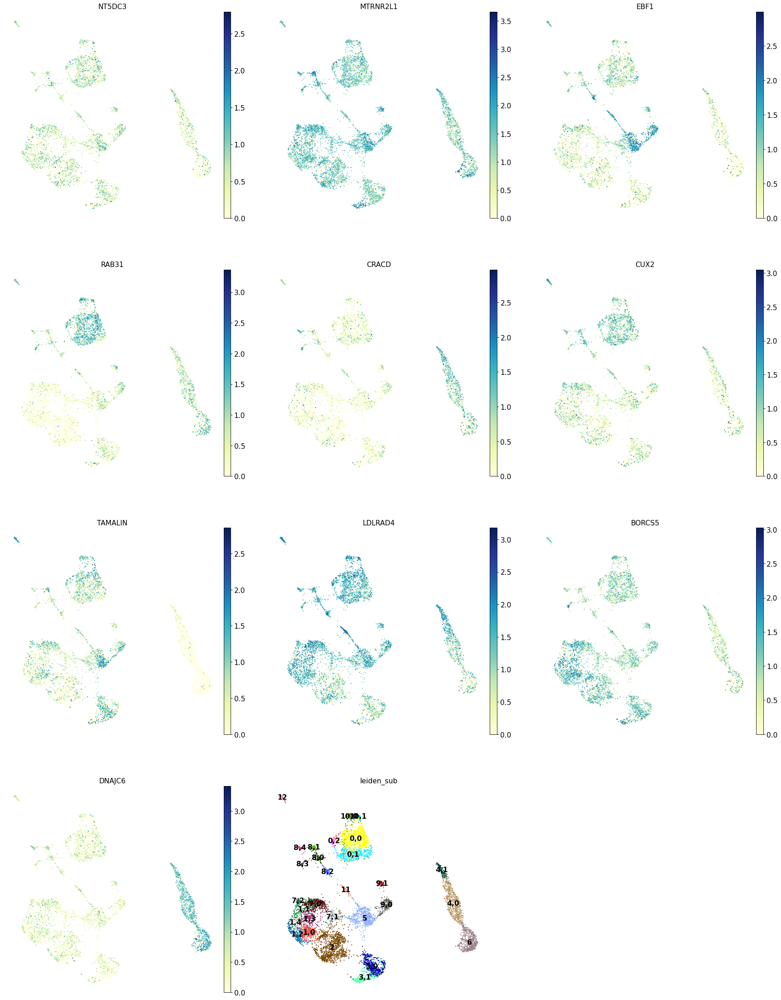

In [95]:
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3,
          legend_loc='on data')

List some good marker genes for each cluster (if it doesn't express known markers)

- 8,0 : 'HSPC' # NT5DC3
- 8,1 : 'HSC' # MTRNR2L1 TAMALIN
- 8,2 : 'Lymph prog'
- 8,3 : 'pro - BORCS5'  # RAB31 BORCS5
- 8,4 : 'pro - DNAJC6'  # DNAJC6 - also accessible in Erythroblast/Reticulocyte clusters, therefore assumed to be MK/E prog cluster 


## Final annotation

In [96]:
final_clus_dict = {
    
    '0,0':'CD14+ Mono',
    '0,1':'CD14+ Mono',
    '0,2':'cDC2',
    
    '1,0':'CD4+ T activated',
    '1,1':'CD4+ T naive',
    '1,2':'CD4+ T activated',
    '1,3':'CD4+ T naive',
    '1,4':'CD4+ T activated',
    
    '2':'CD8+ T',
    
    '3,0':'NK',
    '3,1':'ILC',
    
    '4,0':'Erythroblast',
    '4,1':'Proerythroblast',
    
    '5':'Naive CD20+ B',
    '6':'Reticulocyte',
    
    '7,0':'CD4+ T naive',
    '7,1':'high count - T doublet?',
    '7,2':'CD4+ T naive',
    
    '8,0':'HSPC',
    '8,1':'HSC',
    '8,2':'Lymph prog',
    '8,3':'pro - BORCS5',
    '8,4':'MK/E prog',
    
    '9,0':'B1 B',
    '9,1':'Plasma cells',
    
    '10,0':'CD16+ Mono',
    '10,1':'CD14+ Mono prog',
    
    '11':'Transitional B',
    
    '12':'pDCs',
    
}

## Marker overview

In [97]:
# Rename clusters

adata_atac.obs['leiden_final'] = adata_atac.obs.leiden_sub.map(final_clus_dict)

... storing 'leiden_final' as categorical


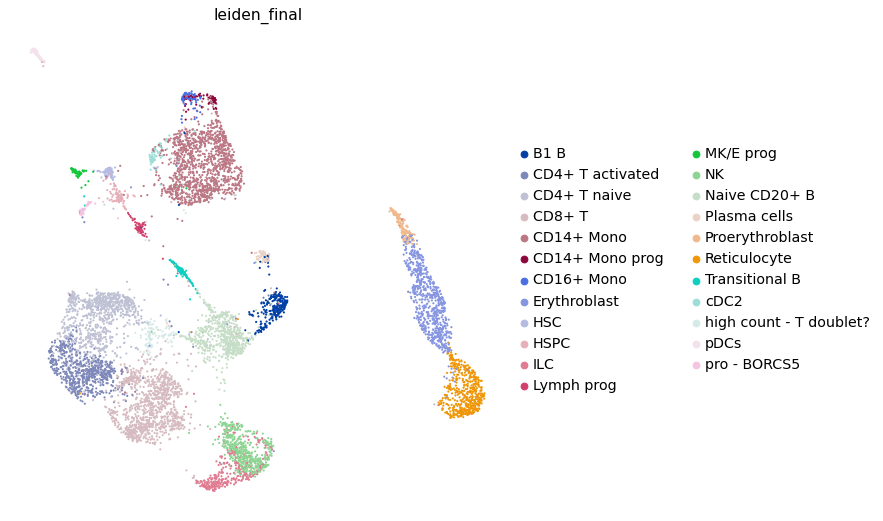

In [98]:
sc.pl.umap(adata_atac, color='leiden_final')

In [99]:
# Updated markes (including new ones for Progenitor clusters)

marker_genes_updated = {
    'CD14+ Mono': ['TREM1', 'FPR1'],
    'CD16+ Mono': ['LYN', 'TCF7L2'],
    'CD14+ Mono prog': ['KLF4'],
    'cDC2': ['TREM1', 'DMXL2'], # Note: DMXL2 should be negative
    'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
    'Erythroblast': ['GATA1', 'MKI67'],
    'Proerythroblast': ['GATA2', 'CRACD', 'SYNGR1'],
    'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
    'ILC': ['SPON2', 'GZMB', 'PRF1', 'CD69'], # Note CD69 should be negative
    'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
    'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
    'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
    'Transitional B': ['MME', 'CD38', 'CD24'],
    'Plasma cells': ['DUSP22', 'FNDC3B'],
    'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
    'CD4+ T naive': [ 'BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'], # Note JAKMIP1 and C4orf50 are negative markers
    'CD8+ T': ['CD8A', 'CD8B'],
    'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
    'HSPC/Mono prog': ['MPO', 'NT5DC3'],
    'HSC': ['PRDM16','TAMALIN','MTRNR2L1'],
    'MK/E prog': ['DNAJC6'],
    'pro - BORCS5': ['BORCS5', 'RAB31']
}


In [100]:
#Overview
adata_plot = adata_atac.copy()
sc.pp.scale(adata_plot, max_value=4)

Note on marker overview: Compared to the RNA seq markers, the gene activity scores are less distict between clusters. Often markers of multiple subtypes need to be assesed together (E.g.: B1 B and naive CD20+ B cells express very similar set of markers (they are bith B cells), but B1 B cells have higher EPHA4 gene activity, therefore distiction can be made)

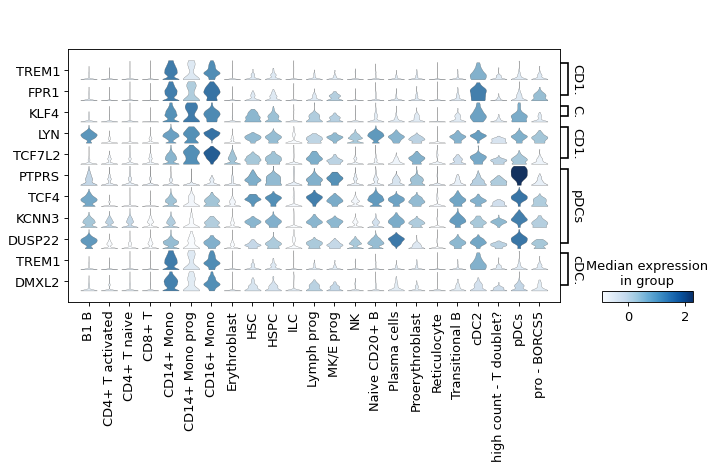

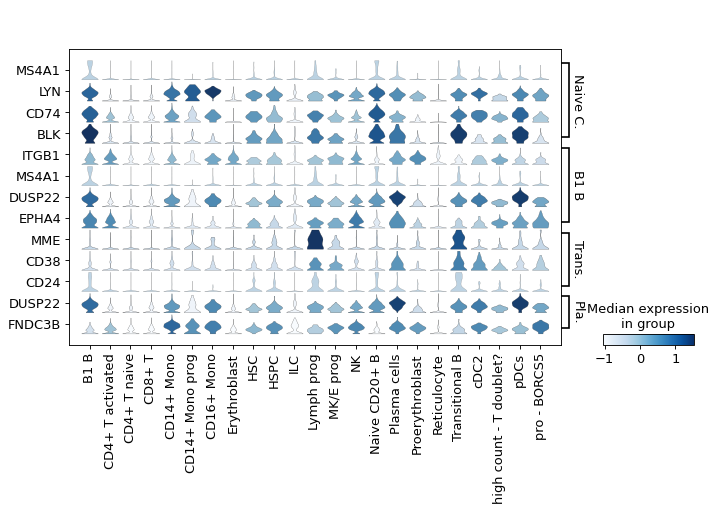

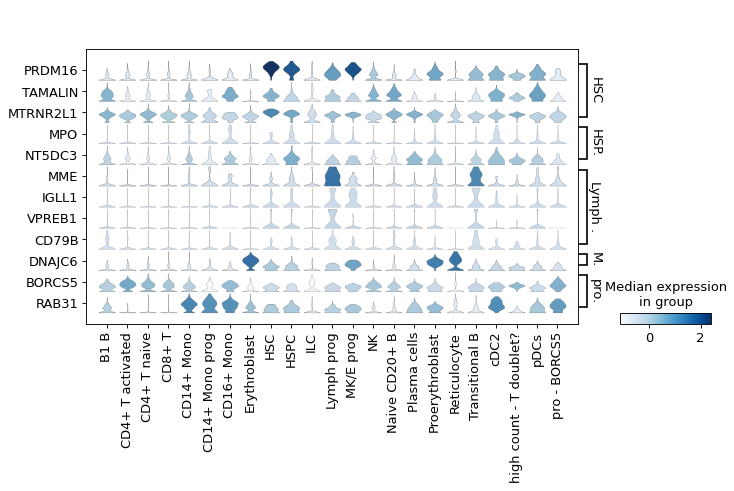

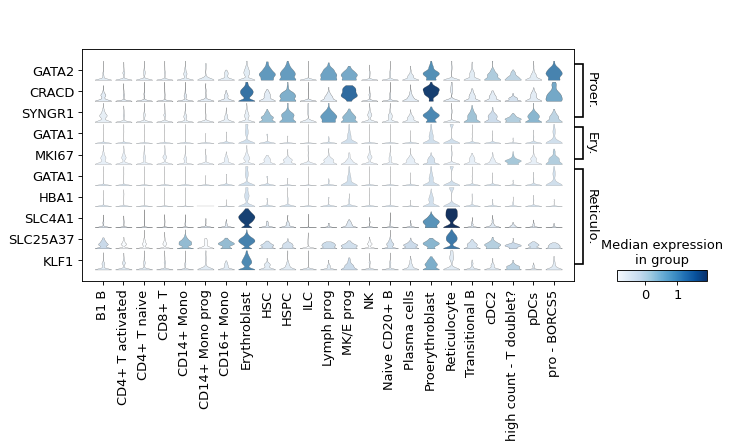

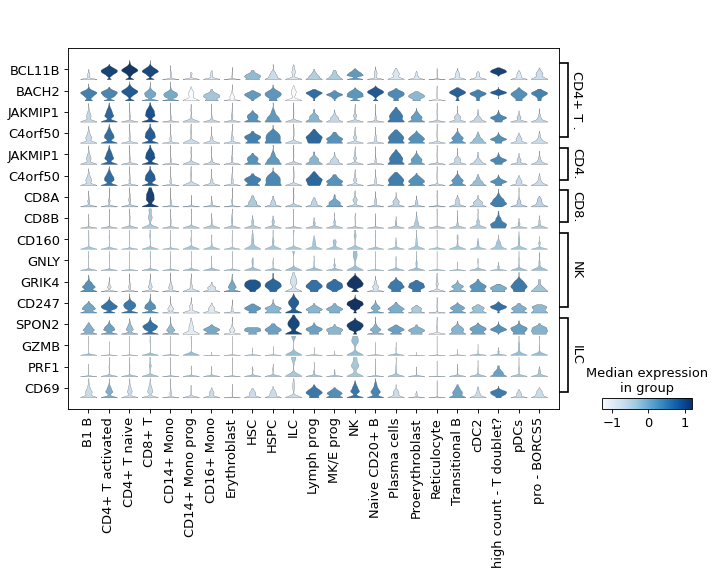

In [101]:
#Monocytes
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['CD14+ Mono', 'CD14+ Mono prog', 'CD16+ Mono', 'pDCs', 'cDC2']})

#B cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells']})

#Progenitors
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['HSC', 'HSPC/Mono prog', 'Lymph prog', 'MK/E prog', 'pro - BORCS5']})

#Erythropoiesis
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['Proerythroblast', 'Erythroblast', 'Reticulocyte']})


#T & NK cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['CD4+ T naive', 'CD4+ T activated', 'CD8+ T', 'NK', 'ILC']})

## Write output

In [102]:
adata_atac

AnnData object with n_obs × n_vars = 8008 × 19029
    obs: 'nCount_peaks', 'atac_fragments', 'TSS.enrichment', 'reads_in_peaks_frac', 'blacklist_fraction', 'nucleosome_signal', 'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'leiden_sub', 'leiden_final'
    uns: 'neighbors', 'leiden', 'leiden_res0.3_colors', 'leiden_res0.5_colors', 'leiden_res0.8_colors', 'leiden_res1_colors', 'rank_genes_res0.5', 'leiden_sub_colors', 'rg_tsub', 'leiden_final_colors'
    obsm: 'lsi_full', 'lsi_red', 'peaks', 'umap'
    obsp: 'distances', 'connectivities'

In [103]:
adata_atac_slim = adata_atac.copy()

In [104]:
adata_atac_slim.obs = adata_atac.obs[['nCount_peaks','atac_fragments',
                                     'reads_in_peaks_frac','blacklist_fraction','nucleosome_signal',
                                     'leiden_final']]
del adata_atac_slim.uns
adata_atac_slim.uns['neighbors'] = adata_atac.uns['neighbors']

In [105]:
adata_atac_slim

AnnData object with n_obs × n_vars = 8008 × 19029
    obs: 'nCount_peaks', 'atac_fragments', 'reads_in_peaks_frac', 'blacklist_fraction', 'nucleosome_signal', 'leiden_final'
    uns: 'neighbors'
    obsm: 'lsi_full', 'lsi_red', 'peaks', 'umap'
    obsp: 'distances', 'connectivities'

In [106]:
adata_atac_slim.write_h5ad('donor1_atac.h5ad')